# Exploring National Data Demand & Generation

In [1]:
import numpy as np
import pandas as pd

import os
import glob

from scipy import stats
from scipy.stats import norm

# plotting
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import seaborn as sns
from pmdarima import auto_arima
from sklearn.metrics import mean_absolute_percentage_error
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.model_selection import TimeSeriesSplit

# stats
from statsmodels.api import tsa # time series analysis
import statsmodels.api as sm
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
plt.style.use('seaborn')

# Loading Data

## Loading Demand Data

In [2]:
# for file in files:
os.chdir("/Users/jad/capstone/data")
demand_list=glob.glob("demand*")
demand_csv=[]

for file in demand_list:
    temp = pd.read_csv(file)
    demand_csv.append(temp)

df = pd.concat(demand_csv,ignore_index=True)

df


,SETTLEMENT_DATE,SETTLEMENT_PERIOD,ND,TSD,ENGLAND_WALES_DEMAND,EMBEDDED_WIND_GENERATION,EMBEDDED_WIND_CAPACITY,EMBEDDED_SOLAR_GENERATION,EMBEDDED_SOLAR_CAPACITY,NON_BM_STOR,PUMP_STORAGE_PUMPING,IFA_FLOW,IFA2_FLOW,BRITNED_FLOW,MOYLE_FLOW,EAST_WEST_FLOW,NEMO_FLOW,NSL_FLOW,ELECLINK_FLOW
0,01-JAN-2022,1,21940,23275,20513,2412,6527,0,13080,0,450,-181,-4,586,320,384,-100,210.0,0.0
1,01-JAN-2022,2,22427,23489,21021,2554,6527,0,13080,0,173,-181,-4,583,320,403,-104,176.0,0.0
2,01-JAN-2022,3,21896,23672,20619,2696,6527,0,13080,0,799,-164,-4,567,320,440,-4,-205.0,0.0
3,01-JAN-2022,4,20693,23272,19615,2838,6527,0,13080,0,1516,-170,-4,444,320,387,-6,-283.0,0.0
4,01-JAN-2022,5,19481,23958,18545,2977,6527,0,13080,0,1490,-753,-4,-383,320,476,-561,-686.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239705,31-DEC-2013,44,32108,33433,29054,1021,2434,0,3345,0,11,1990,0,1000,-230,-484,0,NaN,NaN
239706,31-DEC-2013,45,31101,32343,28062,1021,2434,0,3345,0,10,1990,0,1000,-227,-405,0,NaN,NaN
239707,31-DEC-2013,46,30609,31751,27505,983,2434,0,3345,0,17,1990,0,1000,-233,-292,0,NaN,NaN
239708,31-DEC-2013,47,29890,30944,26798,983,2434,0,3345,0,43,1990,0,1000,-163,-248,0,NaN,NaN


### Cleaning Data

In [3]:
# Making column headers lower case:
df.columns=[x.lower() for x in df.columns]

Converting the data into 30 minute intervals, where each settlement period is the order of the 30 minute intervals within a day. ie. 48 intervals in a day

In [4]:
df["settlement_start_time"] = pd.to_datetime(df["settlement_period"]*30-30, unit="m").dt.time

Making settlement date column into Datetime split by 30m intervals

In [5]:
df['settlement_date']=df['settlement_date'].astype(str) + " " + df["settlement_start_time"].astype(str)

In [6]:
df['settlement_date'] = pd.to_datetime(df['settlement_date'])

In [7]:
df.head()

,settlement_date,settlement_period,nd,tsd,england_wales_demand,embedded_wind_generation,embedded_wind_capacity,embedded_solar_generation,embedded_solar_capacity,non_bm_stor,pump_storage_pumping,ifa_flow,ifa2_flow,britned_flow,moyle_flow,east_west_flow,nemo_flow,nsl_flow,eleclink_flow,settlement_start_time
0,2022-01-01 00:00:00,1,21940,23275,20513,2412,6527,0,13080,0,450,-181,-4,586,320,384,-100,210.0,0.0,00:00:00
1,2022-01-01 00:30:00,2,22427,23489,21021,2554,6527,0,13080,0,173,-181,-4,583,320,403,-104,176.0,0.0,00:30:00
2,2022-01-01 01:00:00,3,21896,23672,20619,2696,6527,0,13080,0,799,-164,-4,567,320,440,-4,-205.0,0.0,01:00:00
3,2022-01-01 01:30:00,4,20693,23272,19615,2838,6527,0,13080,0,1516,-170,-4,444,320,387,-6,-283.0,0.0,01:30:00
4,2022-01-01 02:00:00,5,19481,23958,18545,2977,6527,0,13080,0,1490,-753,-4,-383,320,476,-561,-686.0,0.0,02:00:00


In [8]:
# Renaming column
df = df.rename(columns={"settlement_date":"datetime"})

In [9]:
# Checking column was successfully created 
df.head(1)

,datetime,settlement_period,nd,tsd,england_wales_demand,embedded_wind_generation,embedded_wind_capacity,embedded_solar_generation,embedded_solar_capacity,non_bm_stor,pump_storage_pumping,ifa_flow,ifa2_flow,britned_flow,moyle_flow,east_west_flow,nemo_flow,nsl_flow,eleclink_flow,settlement_start_time
0,2022-01-01,1,21940,23275,20513,2412,6527,0,13080,0,450,-181,-4,586,320,384,-100,210.0,0.0,00:00:00


In [10]:
# Sort data in order, in case it isnt...
df=df.sort_values(by='datetime', ascending=False)

In [11]:
# Checking Index and order has successfully been created
df

,datetime,settlement_period,nd,tsd,england_wales_demand,embedded_wind_generation,embedded_wind_capacity,embedded_solar_generation,embedded_solar_capacity,non_bm_stor,pump_storage_pumping,ifa_flow,ifa2_flow,britned_flow,moyle_flow,east_west_flow,nemo_flow,nsl_flow,eleclink_flow,settlement_start_time
11805,2022-09-03 23:30:00,48,19970,26173,18418,1863,6545,0,13080,0,3,-1030,-1029,-687,54,0,-970,-961.0,-1023.0,23:30:00
11804,2022-09-03 23:00:00,47,20643,26733,19089,1888,6545,0,13080,0,3,-1031,-1029,-582,176,29,-972,-951.0,-1022.0,23:00:00
11803,2022-09-03 22:30:00,46,21703,27191,20135,1913,6545,0,13080,0,3,-1032,-1029,151,244,53,-1010,-891.0,-1023.0,22:30:00
11802,2022-09-03 22:00:00,45,22612,28049,21001,1933,6545,0,13080,0,3,-1021,-1029,151,244,0,-1003,-858.0,-1023.0,22:00:00
11801,2022-09-03 21:30:00,44,23585,28505,21906,1952,6545,0,13080,0,3,-800,-1029,-143,244,37,-785,-637.0,-1023.0,21:30:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29330,2009-01-01 02:00:00,5,35687,37298,31877,50,1403,0,0,0,851,1753,0,0,-160,0,0,NaN,NaN,02:00:00
29329,2009-01-01 01:30:00,4,36426,37775,32526,50,1403,0,0,0,589,1772,0,0,-160,0,0,NaN,NaN,01:30:00
29328,2009-01-01 01:00:00,3,37380,38651,33615,53,1403,0,0,0,511,2002,0,0,-160,0,0,NaN,NaN,01:00:00
29327,2009-01-01 00:30:00,2,38047,38964,34072,53,1403,0,0,0,157,2002,0,0,-160,0,0,NaN,NaN,00:30:00


## Loading Energy Generation Mix Data

In [12]:
df1 = pd.read_csv("df_fuel_ckan.csv")
df1.head()


,DATETIME,GAS,COAL,NUCLEAR,WIND,HYDRO,IMPORTS,BIOMASS,OTHER,SOLAR,...,IMPORTS_perc,BIOMASS_perc,OTHER_perc,SOLAR_perc,STORAGE_perc,GENERATION_perc,LOW_CARBON_perc,ZERO_CARBON_perc,RENEWABLE_perc,FOSSIL_perc
0,2009-01-01 00:00:00+00:00,8432.0,15038.0,7097.0,263.0,246,2500.0,0.0,0.0,0.0,...,7.4,0.0,0.0,0.0,0.0,100.0,22.7,22.7,1.5,69.9
1,2009-01-01 00:30:00+00:00,8564.0,15099.0,7085.0,244.0,245,2478.0,0.0,0.0,0.0,...,7.4,0.0,0.0,0.0,0.0,100.0,22.5,22.5,1.4,70.2
2,2009-01-01 01:00:00+00:00,8535.0,15082.0,7072.0,224.0,246,2443.0,0.0,0.0,0.0,...,7.3,0.0,0.0,0.0,0.0,100.0,22.4,22.4,1.4,70.3
3,2009-01-01 01:30:00+00:00,8374.0,15008.0,7063.0,210.0,246,2416.0,0.0,0.0,0.0,...,7.3,0.0,0.0,0.0,0.0,100.0,22.6,22.6,1.4,70.2
4,2009-01-01 02:00:00+00:00,8341.0,14963.0,7051.0,195.0,246,2344.0,0.0,0.0,0.0,...,7.1,0.0,0.0,0.0,0.0,100.0,22.6,22.6,1.3,70.3


In [13]:
# All the data looks consistent with the same number of inputs and no nulls
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 240613 entries, 0 to 240612
Data columns (total 32 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   DATETIME          240613 non-null  object 
 1   GAS               240613 non-null  float64
 2   COAL              240613 non-null  float64
 3   NUCLEAR           240613 non-null  float64
 4   WIND              240613 non-null  float64
 5   HYDRO             240613 non-null  int64  
 6   IMPORTS           240613 non-null  float64
 7   BIOMASS           240613 non-null  float64
 8   OTHER             240613 non-null  float64
 9   SOLAR             240613 non-null  float64
 10  STORAGE           240613 non-null  int64  
 11  GENERATION        240613 non-null  float64
 12  CARBON_INTENSITY  240613 non-null  float64
 13  LOW_CARBON        240613 non-null  float64
 14  ZERO_CARBON       240613 non-null  float64
 15  RENEWABLE         240613 non-null  float64
 16  FOSSIL            24

### Change to Datetime & Set Index


In [14]:
# Chanege column headers to lowercase
df1.columns=[x.lower() for x in df1.columns]

In [15]:
# Convert datetime column to datetime format -  removing timezone element in the process
df1["datetime"]=pd.to_datetime(df1["datetime"]).dt.tz_convert(None)

In [16]:
# Sort values incase they arent already
df1=df1.sort_values(by='datetime', ascending=True)

df1.head()


,datetime,gas,coal,nuclear,wind,hydro,imports,biomass,other,solar,...,imports_perc,biomass_perc,other_perc,solar_perc,storage_perc,generation_perc,low_carbon_perc,zero_carbon_perc,renewable_perc,fossil_perc
0,2009-01-01 00:00:00,8432.0,15038.0,7097.0,263.0,246,2500.0,0.0,0.0,0.0,...,7.4,0.0,0.0,0.0,0.0,100.0,22.7,22.7,1.5,69.9
1,2009-01-01 00:30:00,8564.0,15099.0,7085.0,244.0,245,2478.0,0.0,0.0,0.0,...,7.4,0.0,0.0,0.0,0.0,100.0,22.5,22.5,1.4,70.2
2,2009-01-01 01:00:00,8535.0,15082.0,7072.0,224.0,246,2443.0,0.0,0.0,0.0,...,7.3,0.0,0.0,0.0,0.0,100.0,22.4,22.4,1.4,70.3
3,2009-01-01 01:30:00,8374.0,15008.0,7063.0,210.0,246,2416.0,0.0,0.0,0.0,...,7.3,0.0,0.0,0.0,0.0,100.0,22.6,22.6,1.4,70.2
4,2009-01-01 02:00:00,8341.0,14963.0,7051.0,195.0,246,2344.0,0.0,0.0,0.0,...,7.1,0.0,0.0,0.0,0.0,100.0,22.6,22.6,1.3,70.3


In [17]:
# Querying a random sample to check all is functioning well
df1[df1["datetime"] == "2022-09-03 23:30:00"]

,datetime,gas,coal,nuclear,wind,hydro,imports,biomass,other,solar,...,imports_perc,biomass_perc,other_perc,solar_perc,storage_perc,generation_perc,low_carbon_perc,zero_carbon_perc,renewable_perc,fossil_perc
239711,2022-09-03 23:30:00,9950.0,631.0,5340.0,8233.0,98,74.0,1212.0,437.0,0.0,...,0.3,4.7,1.7,0.0,0.2,100.0,57.2,52.5,32.0,40.6


## Join Both Tables

In [18]:
# Combine both tables into one dataframe
df = pd.merge(df,df1,how="inner",on="datetime")

In [19]:
# Set index as datetime index for comined dataframe
df = df.set_index(df["datetime"])

In [20]:
# Making columns headers lower case 
df.columns=[x.lower() for x in df.columns]

### Make new column for years & months 

In [21]:
df["year"] = df["datetime"].dt.year

In [22]:
df["month"]= df["datetime"].dt.month

### Weekday / End

In [23]:
# Creating day of the week column
df['day_of_week'] = df['datetime'].dt.dayofweek

In [24]:
# Defining weekdays with 1
df["weekday"] = df['datetime'].dt.dayofweek < 4

In [25]:
# Converting folumn to int data type 
df["weekday"] = df["weekday"].astype('int')

In [26]:
# Checking to see that dtype conversion to int was successful 
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 239710 entries, 2022-09-03 23:30:00 to 2009-01-01 00:00:00
Data columns (total 55 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   datetime                   239710 non-null  datetime64[ns]
 1   settlement_period          239710 non-null  int64         
 2   nd                         239710 non-null  int64         
 3   tsd                        239710 non-null  int64         
 4   england_wales_demand       239710 non-null  int64         
 5   embedded_wind_generation   239710 non-null  int64         
 6   embedded_wind_capacity     239710 non-null  int64         
 7   embedded_solar_generation  239710 non-null  int64         
 8   embedded_solar_capacity    239710 non-null  int64         
 9   non_bm_stor                239710 non-null  int64         
 10  pump_storage_pumping       239710 non-null  int64         
 11  ifa_flow          

We can also see that the data for the most part is consistent across most of the columns with 239710 inputs for all the columns except some of the energy export links "nsl_flow" & eleclink_flow" this is data we wont be using but presumably they havent been utilised since 2009

## Editing DF Columns

### Drop redundant columns

In [27]:
df.columns

Index(['datetime', 'settlement_period', 'nd', 'tsd', 'england_wales_demand',
       'embedded_wind_generation', 'embedded_wind_capacity',
       'embedded_solar_generation', 'embedded_solar_capacity', 'non_bm_stor',
       'pump_storage_pumping', 'ifa_flow', 'ifa2_flow', 'britned_flow',
       'moyle_flow', 'east_west_flow', 'nemo_flow', 'nsl_flow',
       'eleclink_flow', 'settlement_start_time', 'gas', 'coal', 'nuclear',
       'wind', 'hydro', 'imports', 'biomass', 'other', 'solar', 'storage',
       'generation', 'carbon_intensity', 'low_carbon', 'zero_carbon',
       'renewable', 'fossil', 'gas_perc', 'coal_perc', 'nuclear_perc',
       'wind_perc', 'hydro_perc', 'imports_perc', 'biomass_perc', 'other_perc',
       'solar_perc', 'storage_perc', 'generation_perc', 'low_carbon_perc',
       'zero_carbon_perc', 'renewable_perc', 'fossil_perc', 'year', 'month',
       'day_of_week', 'weekday'],
      dtype='object')

In [28]:
# Make a copy of the original df
df_all = df.copy()

#Filtering down the df to only include the columns that I need
df = df[['datetime','year', 'month','day_of_week','weekday', 'nd','renewable','wind', 'solar',
       'generation']]


In [29]:
# Saving a copy to folder
df.to_csv(r'C:\Users\jad\capstone\data\energy_data.csv', encoding='UTF-8', sep='\t')

### Make new column for months

In [30]:
# Renaming column
df = df.rename(columns={"nd":"demand_national"})

### Checking for missing / consistent  data

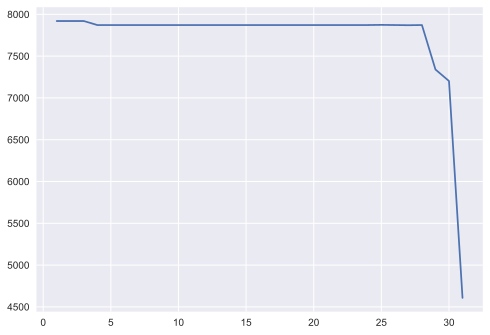

In [31]:
#checking for missing data by looking at the conistency of data across days of the month
sns.color_palette("tab10")
plt.plot(df.groupby(df["datetime"].dt.day)["year"].count())



The data looks consistent across the dataset. There is a slight drop at the end due to some months not having 30 days and others having 31 days. This can also be attributed to the fact that 2022 has not finished as such the data is inconclusive across the whole year and so some months will have more values than others for a particular day of the year across the dataset.

# EDA

## Exploring Energy Demand 

### National Demand in Months

<AxesSubplot:title={'center':'National Energy Demand (MW) - Dropping Over Time'}, xlabel='month', ylabel='year'>

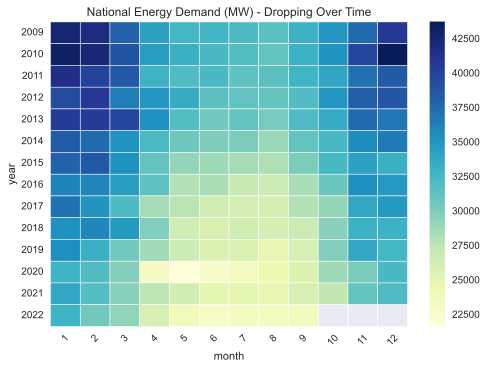

In [32]:
#Plotting National Demand in a heatmap / grid

# Grouping by months in years, then taking the count
grp1 = df.groupby(['year','month'])["demand_national"].count()
# Grouping by months in years, then taking the sum
grp2 = df.groupby(['year','month'])["demand_national"].sum()
# Dividing by both grouped variables to find mean
grp3 = grp2/grp1
# Unstacking grp3 (means) in order to grid the data
avg_mnth=grp3.unstack()
# Plotting data as a heatmap
hm1 = sns.heatmap(avg_mnth, linewidths=.5,cmap="YlGnBu")
plt.xticks(rotation=45)
plt.title("National Energy Demand (MW) - Dropping Over Time")
display(hm1)

In [33]:
avg_mnth.columns

Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12], dtype='int64', name='month')

In [34]:
print('Month with highest energy usage in past 14 years')
print(grp3[grp3 == grp3.max()])

Month with highest energy usage in past 14 years
year  month
2010  12       43693.046371
Name: demand_national, dtype: float64


In [35]:
print('Month with lowest energy usage in past 14 years:')
print(grp3[grp3 == grp3.min()])

Month with lowest energy usage in past 14 years:
year  month
2020  5        21610.885081
Name: demand_national, dtype: float64


In [36]:
print('Max monthly average is',round((grp3.max()/grp3.min())*100,2),'%', 'higher than the minimum monthly average across the 14 years')

Max monthly average is 202.18 % higher than the minimum monthly average across the 14 years


We can see a clear drop in energy usage for both winter and summer months since 2009, with summer months in particular going from an average of 30k-35k MW to 22k-30k MW. The tail-end months (12-1,2) of 2009-2010 generally have the highest usage across all of the months, while months 5-9 generally have the lowest. This can be supported by the fact that the highest and usage for any month was December 2010 where the usage was just over double (202%) that of the lowest month which was May 2022.

### National Energy Demand - Timeseries

In [37]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df.index, y=df['demand_national'], mode='lines'))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title='National Energy Demand'
)
fig.show()

The above visualisation of energy demand across the 14 years is plotted using data at a 30minute interval granularity. As the visualisation makes apparent, it is not easy to interporate. As such, we will resample the data to take the average data on a monthly level of a granularity.

In [38]:
# Resampling national demand data to be monthly as opposed to a granularity of 30min periods. 
# This aggregates the data, reducing noise and speeding up processing time
nd = df['demand_national'].resample('1M').mean()

In [39]:
avg_yr = df.groupby(df.index.year)['demand_national'].mean()

In [40]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=nd.index, y=nd, mode='lines',name='National Demand (M)'))
fig.add_trace(go.Scatter(x=df.groupby(df.index.year)['demand_national'].mean().index,y=df.groupby(df.index.year)['demand_national'].mean(), mode="lines",name='Mean National Demand'))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title='National Energy Demand'
)
fig.show()

There is a clear trend & seasonality in the data. The trend supports the previous observations from the heat-map, which showed that there has been a gradual decline in energy demand (consumption) over the years. This is made clearer when observing the the annual mean plotted with the demand. We do see every year declining as compared with the previous year with the exception of 2010 and 2021. 

2021 also appears to be the beginning of an inflection point in the timeseries. We see this at minimum monthly point in May of 2020. This is attributed to "mobility, economic activity, construction and manufacturing, dropping the global energy demand."

### Seasonality - Monthly Averages

Text(0.5, 1.0, 'Avg.Monthly National Demand - Peaks in Jan')

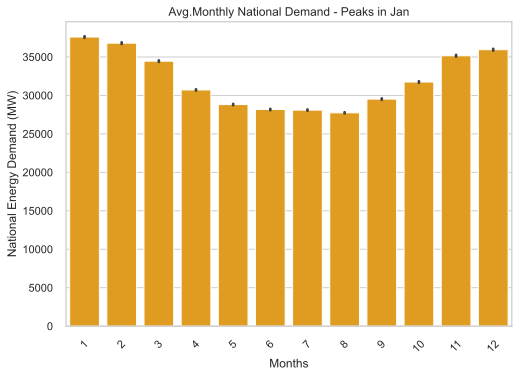

In [41]:
sns.set_theme(style="whitegrid")
sns.barplot(data=df,x=df["month"],y=df['demand_national'],color="orange")
plt.xticks(rotation=45)
plt.ylabel("National Energy Demand (MW)")
plt.xlabel("Months")
plt.title("Avg.Monthly National Demand - Peaks in Jan")


The above visual takes the average for each month across the all 14 years in the time-series data. We can see a clear parabolic seasonal trend which which supports the observations from the heatmap produced above. The highest average months are January and February with energy demand dipping in the warmer seasons and then increasing again towards the latter months of the year. On average, the month with the lowest demand is August. Since May isn't the lowest month, this reinforces the point that May 2021 is an anomalous point that is the product of exogenous macro factors. 

In [42]:
# plt.legend(grp3.columns)
# plt.ylabel("National Energy Demand (MW)")

# add lines for each column
fig1 = px.line(df.groupby(["year"])["demand_national"].sum().head(13))

fig1.update_layout(
    yaxis_title="Total National Demand (MW)", 
    title="Total Annual National Energy Demand - Across 14 Years"
)

# activate slider
fig1.update_xaxes(rangeslider_visible=True)

fig1.show()

The above graph shows the sum of total energy demand aggregated yearly across the 13 years (excluded 2022 as it is incomplete). This graphic allows us to easily see the inflection point that begins in 2020 and the steady decline in energy consumption. The biggest yoy drop across the years is ~7% drop in total MWs used was between 2019 - 2020. 

## Exploring Renewable Energy Generation

### Total Energy Gen

#### Total Energy Gen - Heatmap

In [43]:
# Resampling the total renewable generation data to monthly
renew = pd.DataFrame(df['renewable'].resample('1M').mean())
renew['renewable'] = df['renewable'].resample('1M').mean()

<AxesSubplot:title={'center':'Ttl Renewable Energy Gen (MW) - Ever Increasing'}, xlabel='month', ylabel='year'>

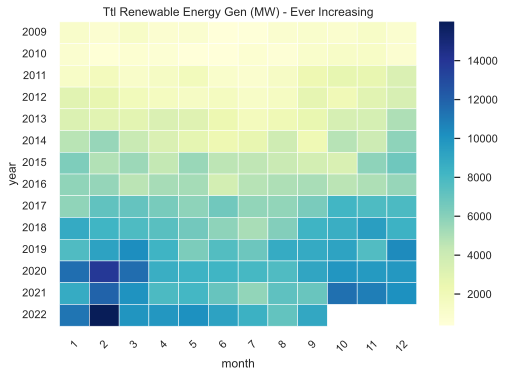

In [44]:
# Grouping by months in years, then taking the count
grp1 = df.groupby(['year','month'])["renewable"].count()
# Grouping by months in years, then taking the sum
grp2 = df.groupby(['year','month'])["renewable"].sum()
# Dividing by both grouped variables to find mean
grp3 = grp2/grp1
# Unstacking grp3 (means) in order to grid the data
avg_mnth=grp3.unstack()
# Plotting data as a heatmap
hm1 = sns.heatmap(avg_mnth, linewidths=.5,cmap="YlGnBu")
plt.xticks(rotation=45)
plt.title("Ttl Renewable Energy Gen (MW) - Ever Increasing")
display(hm1)

The graphic above helps us intuitively visualise the months in-which renewable energy is most produced. We can see that most renewable energy is produced at the beginning and end of the years. This is caused by the fact that most of renewable energy is made up of wind energy. When compared to wind energy we should see that the summer months are slightly less dark (and much darker if the data was standardized).

#### Total Energy Gen - Monthly Avg

To make the seasonal trend even more easy to interporate we can plot the average across the whole timeseries:

Text(0.5, 1.0, 'Avg.Monthly National Demand - Peaks in Jan')

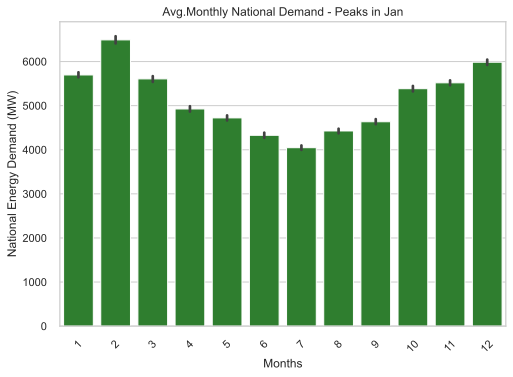

In [45]:
sns.set_theme(style="whitegrid")
sns.barplot(data=df,x=df["month"],y=df['renewable'],color="forestgreen")
plt.xticks(rotation=45)
plt.ylabel("National Energy Demand (MW)")
plt.xlabel("Months")
plt.title("Avg.Monthly National Demand - Peaks in Jan")

From the above graph we can see the following:
    
- On average months with the highest renewable energy generation is February 
- On average July has the least amount of renewable energy produced
- There is a parablic trend across the year where hotter months tend to perform worse than colder months, this is due to Solar energy not generating enough to offset the losses in Wind Energy generation in these months

### Wind Energy Gen

#### Wind Energy Gen  - Heatmap

<AxesSubplot:title={'center':'Wind Energy Gen (MW) - Increasing Over Time'}, xlabel='month', ylabel='year'>

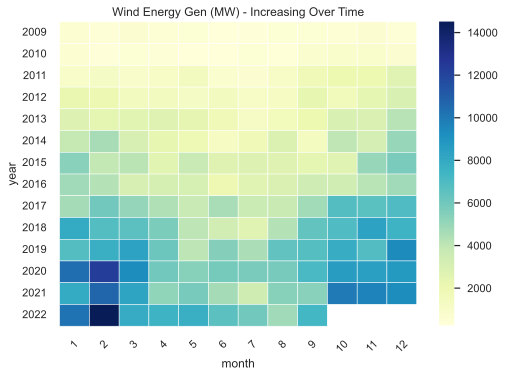

In [46]:
#Plotting National Demand in a heatmap / grid

# Grouping by months in years, then taking the count
grp1 = df.groupby(['year','month'])["wind"].count()
# Grouping by months in years, then taking the sum
grp2 = df.groupby(['year','month'])["wind"].sum()
# Dividing by both grouped variables to find mean
grp3 = grp2/grp1
# Unstacking grp3 (means) in order to grid the data
avg_mnth=grp3.unstack()
# Plotting data as a heatmap
hm1 = sns.heatmap(avg_mnth, linewidths=.5,cmap="YlGnBu")
plt.xticks(rotation=45)
plt.title("Wind Energy Gen (MW) - Increasing Over Time")
display(hm1)

The graphic above helps us better understand the wind energy production across the years and months. We can see that most wind energy is produced at the beginning and end of the years. As predicted, when compared to total renewable energy, we see that the summer months are lighter.

#### Wind Energy Gen  - Monthly Avg

Text(0.5, 1.0, 'Avg. Monthly Wind Generation - Peaks in Feb')

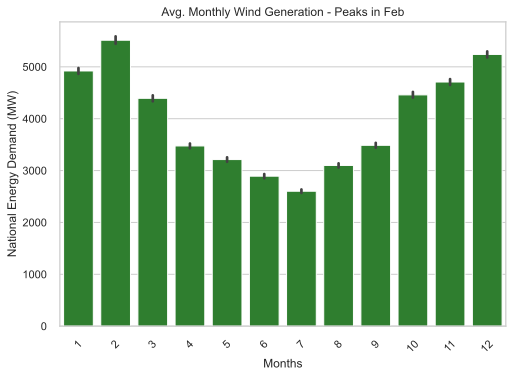

In [47]:
sns.set_theme(style="whitegrid")
sns.barplot(data=df,x=df["month"],y=df['wind'],color="forestgreen")
plt.xticks(rotation=45)
plt.ylabel("National Energy Demand (MW)")
plt.xlabel("Months")
plt.title("Avg. Monthly Wind Generation - Peaks in Feb")#### Wind Energy Gen  - Heatmap

From the above graph we can see the following:
    
- On average months with the highest wind energy generation is February 
- On average July has the least amount of wind energy produced
- There is a parablic trend across the year where hotter months tend to perform worse than colder months
- Interestingly we see a dip between December and January before February peaks then is followed by the biggest change (dip) across the months moving into March

### Solar Energy Gen 

#### Solar Energy Gen  - Heatmap 

In [48]:
# Resampling the individual generation mix types to monthly
renew['solar'] = df['solar'].resample('1M').mean()
renew['wind'] = df['wind'].resample('1M').mean()

<AxesSubplot:title={'center':'Solar Energy Gen (MW) - Less sunlight in the winter'}, xlabel='month', ylabel='year'>

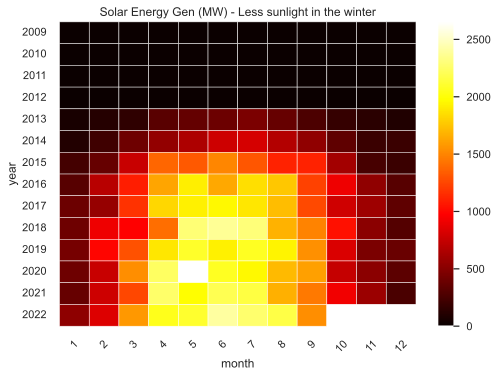

In [49]:
# Grouping by months in years, then taking the count
grp1 = df.groupby(['year','month'])["solar"].count()
# Grouping by months in years, then taking the sum
grp2 = df.groupby(['year','month'])["solar"].sum()
# Dividing by both grouped variables to find mean
grp3 = grp2/grp1
# Unstacking grp3 (means) in order to grid the data
avg_mnth=grp3.unstack()
# Plotting data as a heatmap
hm1 = sns.heatmap(avg_mnth, linewidths=.5,cmap="hot")
plt.xticks(rotation=45)
plt.title("Solar Energy Gen (MW) - Less sunlight in the winter")
display(hm1)

From the graphic above we can see that most solar energy is produced in the months with longer daylight hours.  While the winter months collect little to no energy, there does seem to be an increase in the minimum amount collected over time, where solar energy is now collecting slightly more energy year on year in winter months

#### Solar Energy Gen  - Monthly Avg 

Text(0.5, 1.0, 'Avg.Monthly Solar Gen - Peaks in May')

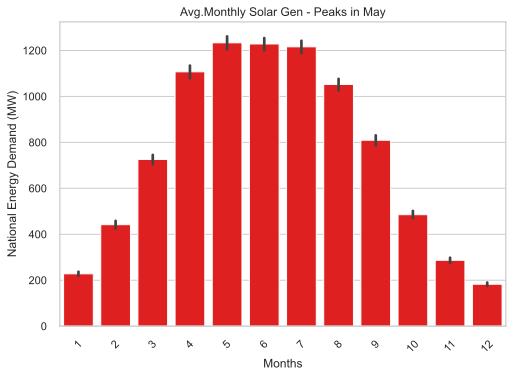

In [50]:
sns.set_theme(style="whitegrid")
sns.barplot(data=df,x=df["month"],y=df['solar'],color="red")
plt.xticks(rotation=45)
plt.ylabel("National Energy Demand (MW)")
plt.xlabel("Months")
plt.title("Avg.Monthly Solar Gen - Peaks in May")

From the above graph we can see the following:
    
- On average months with the highest solar energy generation is May 
- On average December has the least amount of wind energy produced
- There is a parabolic trend across the year where colder months tend to perform worse than warmer months, this would be due to multiple factors but would most definitely be caused by less daylight hours in colder months

### Overall Generation Mix Plotted 

In [51]:
# Plotting total renewable generation mix along with solar and wind for comparison
fig = go.Figure()
fig.add_trace(go.Scatter(x=renew.index, y=renew['renewable'], mode='lines', name="Renewables"))
fig.add_trace(go.Scatter(x=renew.index, y=renew['wind'], mode='lines', name="Wind"))
fig.add_trace(go.Scatter(x=renew.index, y=renew['solar'], mode='lines', name="Solar"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Generated (MW)", 
    xaxis_title="Date",
    title='Renewable Energy Generation'
)
fig.show()

The above graph visualises the monthly mean data for the total generation Renewable as well as the generation of Wind & Solar which make up the majority of the Renewable energy generated in the UK.

From this graphic we can affirm the following:

- Wind makes up the majority of Renewable energy produced nationally
- Total Renewable energy generation is increasing consistently across the 14 years
- Increase is due to Wind Energy production increasing consistently and with observable heteroscedasticity i.e. the variance is increasing over time
- Solar energy has never accounted for more of the energy generation than Wind
- Solar energy and Wind energy have a clear seasonality, with both of their respective seasonal cycles peak out of sync from one another i.e. Solar energy is mostly produced in the summer when Wind energy is least generated
- There is no solar data prior to 2013, presumably because it didn't account for a large enough amount of energy to justify the collection of the data
- Solar energy is increasing at a much slower pace than Wind energy, presumably because the UK is best suited for Wind Generation
- Solar energy generation is almost non-existent in the winter months

## Plotting Demand & Renewables 

In [52]:
import plotly.graph_objects as go

# Set up the Figure 
fig3 = go.Figure()


# Now add the scatter points for each species individually 
# Seperate the dataframe by species

# Create the graph data objects
chart_data1 = go.Scatter(x=df.groupby(df.index.year)['demand_national'].mean().index,y=df.groupby(df.index.year)['demand_national'].mean(), name='National Demand', mode="lines")
chart_data2 = go.Scatter(x=df.groupby(df.index.year)['renewable'].mean().index,y=df.groupby(df.index.year)['renewable'].mean(), name='Renewable Gen', mode="lines")
chart_data4 = go.Scatter(x=df.groupby(df.index.year)['solar'].mean().index, y= df.groupby(df.index.year)['solar'].mean(), name='Solar Gen', mode = 'lines')
chart_data3 = go.Scatter(x=df.groupby(df.index.year)['wind'].mean().index, y= df.groupby(df.index.year)['wind'].mean(), name='Wind Gen', mode = 'lines')


# Use add_trace()
fig3.add_trace(chart_data1)
fig3.add_trace(chart_data2)
fig3.add_trace(chart_data3)
fig3.add_trace(chart_data4)

# Create the layout object and add it to the figure
chart_layout = go.Layout(width=800,height=600, title="We're on track to supply everything with Renewables" , xaxis_title='Year', yaxis_title='Yearly Avg. MW ')
fig3.update_layout(chart_layout)
fig3.update_xaxes(rangeslider_visible=True)
fig3.show()

The above visualisation intends to depict the converging relationship between Avg.National Energy Demand & Renewable Energy Consumption. In order to do this we plot the mean MW value recorded across the year. 

While both datasets are affected by macro/political/technological factors, we are able to see a convergence in both of the overall trends. We can also observe a generally linear trend for both converging trends.

As such we may deduce that there could be an intersection in the future. This intersection will mark a point at which we are able to fulfill national demand with renewable energy. We will aim to find this intersection point further in the project.

In [235]:
import plotly.graph_objects as go

# Set up the Figure 
fig4 = go.Figure()


# Now add the scatter points for each species individually 
# Seperate the dataframe by species

# Create the graph data objects
chart_2 = go.Scatter(x=df.groupby(df.index.month)['renewable'].mean().index,y=df.groupby(df.index.month)['renewable'].mean(), name='Renewable Gen', mode="lines")
chart_4 = go.Scatter(x=df.groupby(df.index.month)['solar'].mean().index, y= df.groupby(df.index.month)['solar'].mean(), name='Solar Gen', mode = 'lines')
chart_3 = go.Scatter(x=df.groupby(df.index.month)['wind'].mean().index, y= df.groupby(df.index.month)['wind'].mean(), name='Wind Gen', mode = 'lines')


# Use add_trace()
fig4.add_trace(chart_2)
fig4.add_trace(chart_3)
fig4.add_trace(chart_4)

# Create the layout object and add it to the figure
chart_layout = go.Layout(width=800,height=800, title="We're far from meeting Demand with Renewables" , xaxis_title='Month', yaxis_title='Monthly Avg. MW ')
fig4.update_layout(chart_layout)
fig4.update_xaxes(rangeslider_visible=True)
fig4.show()

In [53]:
import plotly.graph_objects as go

# Set up the Figure 
fig4 = go.Figure()


# Now add the scatter points for each species individually 
# Seperate the dataframe by species

# Create the graph data objects
chart_1 = go.Scatter(x=df.groupby(df.index.month)['demand_national'].mean().index,y=df.groupby(df.index.month)['demand_national'].mean(), name='National Demand', mode="lines")
chart_2 = go.Scatter(x=df.groupby(df.index.month)['renewable'].mean().index,y=df.groupby(df.index.month)['renewable'].mean(), name='Renewable Gen', mode="lines")
chart_4 = go.Scatter(x=df.groupby(df.index.month)['solar'].mean().index, y= df.groupby(df.index.month)['solar'].mean(), name='Solar Gen', mode = 'lines')
chart_3 = go.Scatter(x=df.groupby(df.index.month)['wind'].mean().index, y= df.groupby(df.index.month)['wind'].mean(), name='Wind Gen', mode = 'lines')


# Use add_trace()
fig4.add_trace(chart_1)
fig4.add_trace(chart_2)
fig4.add_trace(chart_3)
fig4.add_trace(chart_4)

# Create the layout object and add it to the figure
chart_layout = go.Layout(width=800,height=600, title="We're far from meeting Demand with Renewables" , xaxis_title='Month', yaxis_title='Monthly Avg. MW ')
fig4.update_layout(chart_layout)
fig4.update_xaxes(rangeslider_visible=True)
fig4.show()

The above graph shows the monthly average data for Demand, Renewable Gen, Wind & Solar gen. From this we are able to see the aggregated monthly trends across the annual calender. This visual is also helpful in contextualising the different scales of each variables respective unit value (MW). 

From this graph we can ascertain the following:
- Month where demand is at it's lowest, wind gen is also at it's lowest and thus renewable gen is also at it's lowest
- In the summer solar gets close to generating more energy than wind but does not
- In the summer solar energy makes up a larger portion of renewable gen (gap between green and red line widens)

## Exogenous Feature Engineering

In this section we will be engineering features that may have a causal affect on energy demand and renewable generation. These variables may be used as exogenous regressors in a SARIMAX function later on in the notebook. 

### Quarters

As per EDA we know that Q1 of every year is when demand peaks. As such we can engineer binary feature that adds a weighting that favurs these months in our dataset.

In [54]:
df

,datetime,year,month,day_of_week,weekday,demand_national,renewable,wind,solar,generation
datetime,,,,,,,,,,
2022-09-03 23:30:00,2022-09-03 23:30:00,2022,9,5,0,19970,8331.0,8233.0,0.0,26039.0
2022-09-03 23:00:00,2022-09-03 23:00:00,2022,9,5,0,20643,8502.0,8403.0,0.0,26753.0
2022-09-03 22:30:00,2022-09-03 22:30:00,2022,9,5,0,21703,8563.0,8445.0,0.0,28202.0
2022-09-03 22:00:00,2022-09-03 22:00:00,2022,9,5,0,22612,8761.0,8642.0,0.0,28765.0
2022-09-03 21:30:00,2022-09-03 21:30:00,2022,9,5,0,23585,8847.0,8745.0,0.0,29209.0
...,...,...,...,...,...,...,...,...,...,...
2009-01-01 02:00:00,2009-01-01 02:00:00,2009,1,3,1,35687,441.0,195.0,0.0,33140.0
2009-01-01 01:30:00,2009-01-01 01:30:00,2009,1,3,1,36426,456.0,210.0,0.0,33317.0
2009-01-01 01:00:00,2009-01-01 01:00:00,2009,1,3,1,37380,470.0,224.0,0.0,33602.0


In [55]:
df['quarter'] = df['datetime'].dt.quarter

In [56]:
df['Q1'] = df['quarter'].apply(lambda x: 1 if x == 1 else 0)

In [57]:
df['Q1']

datetime
2022-09-03 23:30:00    0
2022-09-03 23:00:00    0
2022-09-03 22:30:00    0
2022-09-03 22:00:00    0
2022-09-03 21:30:00    0
                      ..
2009-01-01 02:00:00    1
2009-01-01 01:30:00    1
2009-01-01 01:00:00    1
2009-01-01 00:30:00    1
2009-01-01 00:00:00    1
Name: Q1, Length: 239710, dtype: int64

### Holidays

We can import UK Bank holiday dates to assess whether they have a causal affect on energy consumption. That said, both datasets will be resampled to monthly average for speed of modeling and to make it easier to identify trends. This means Holiday info will be a ratio for each month which represents the proportion relative to other moths that there are bank holidays. This probably wont reap any valuable insights as it's too granular, but it's a simple enough thought exercise to test.

In [58]:
holiday = pd.read_csv('UK Bank Holidays.csv')

In [59]:
holiday['Date'] = pd.to_datetime(holiday['Date'])

In [60]:
holiday.set_index(holiday['Date'],inplace=True)

In [61]:
holiday = holiday[holiday['Bank Holiday']==1]

In [62]:
holiday.tail()

,Name,Bank Holiday,Date
Date,,,
2020-05-04,May Day (Early May Bank Holiday),1,2020-05-04
2020-05-25,Spring Bank Holiday,1,2020-05-25
2020-08-31,Summer Bank Holiday,1,2020-08-31
2020-12-25,Christmas,1,2020-12-25
2020-12-28,Boxing Day,1,2020-12-28


In [63]:
df =pd.merge(df,holiday, how='outer', left_index=True, right_index=True)

In [64]:
df.fillna(0,inplace=True)

In [65]:
df['Bank Holiday'] = df['Bank Holiday'].astype('int')

In [66]:
df['Bank Holiday'] = df.apply(lambda x: 1 if x.name.strftime('%m%d') in list(holiday.index.strftime('%m%d')) else 0,axis=1)

In [67]:
df.tail()

,datetime,year,month,day_of_week,weekday,demand_national,renewable,wind,solar,generation,quarter,Q1,Name,Bank Holiday,Date
2022-09-03 21:30:00,2022-09-03 21:30:00,2022,9,5,0,23585,8847.0,8745.0,0.0,29209.0,3,0,0,0,0
2022-09-03 22:00:00,2022-09-03 22:00:00,2022,9,5,0,22612,8761.0,8642.0,0.0,28765.0,3,0,0,0,0
2022-09-03 22:30:00,2022-09-03 22:30:00,2022,9,5,0,21703,8563.0,8445.0,0.0,28202.0,3,0,0,0,0
2022-09-03 23:00:00,2022-09-03 23:00:00,2022,9,5,0,20643,8502.0,8403.0,0.0,26753.0,3,0,0,0,0
2022-09-03 23:30:00,2022-09-03 23:30:00,2022,9,5,0,19970,8331.0,8233.0,0.0,26039.0,3,0,0,0,0


In [68]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 239710 entries, 2009-01-01 00:00:00 to 2022-09-03 23:30:00
Data columns (total 15 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   datetime         239710 non-null  datetime64[ns]
 1   year             239710 non-null  int64         
 2   month            239710 non-null  int64         
 3   day_of_week      239710 non-null  int64         
 4   weekday          239710 non-null  int64         
 5   demand_national  239710 non-null  int64         
 6   renewable        239710 non-null  float64       
 7   wind             239710 non-null  float64       
 8   solar            239710 non-null  float64       
 9   generation       239710 non-null  float64       
 10  quarter          239710 non-null  int64         
 11  Q1               239710 non-null  int64         
 12  Name             239710 non-null  object        
 13  Bank Holiday     239710 non-null  int64 

### Weather Data

Taking historic weather data for the full period of the Demand and Generation data, we can test for the presence of correlations between certain weather attributes and our energy data. 

In [69]:
wthr = pd.read_csv('united kingdom 2009-01-01 to 2022-10-31.csv')

In [70]:
wthr["datetime"] = pd.to_datetime(wthr['datetime'])

In [71]:
wthr.set_index('datetime',inplace=True)

In [72]:
wthr.drop(['sunelevation','sunrise','sunset'], inplace=True,axis=1)

In [73]:
# Resampling to monthly average to remove the noise
wthr = wthr.resample('m').mean()

Scale the data so that it's all about X=0 and has a similar magnitude of influence if we decide to forecast with these weather attributes as exogenous variables:

In [74]:
from sklearn.preprocessing import StandardScaler

stdsclr = StandardScaler() 

wthr_scld = pd.DataFrame(stdsclr.fit_transform(wthr),columns=wthr.columns,index=wthr.index)

<AxesSubplot:title={'center':'Plotting Scaled Weather Attributes'}, xlabel='datetime'>

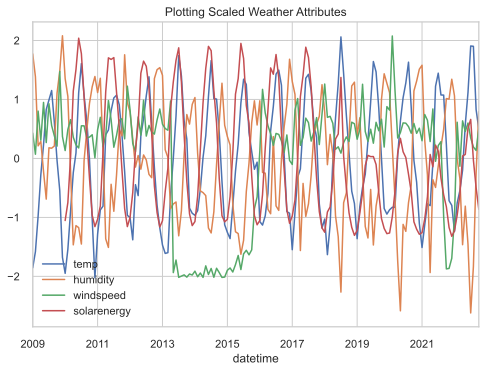

In [75]:
wthr_scld.plot(title="Plotting Scaled Weather Attributes")

In [76]:
wthr.to_csv('UK monthly 2009-01-01 to 2022-10-31.csv')

We can see from the above graph that all the weatehr data is now being plotted about the X axis. Seasonality can also be observed among the different attributes. 

## Demand - SMA

In this section we are creating features from simple moving averages of the demand data at different window sizes. By doing this we can identify the best period for removing seasonality and isolating the trend. 
The trend can then fit a linear regression model to plot the line of best fit (least squares); we can then extrapolate this to find the date at which we can - theoretically - expect renewable energy to fulfill National Energy demand

In [77]:
from statsmodels.tsa.seasonal import seasonal_decompose


In [78]:
demand = pd.DataFrame(df['demand_national'],index=df.index)

In [79]:
demand = demand.resample('m').mean()

In [80]:
demand.columns

Index(['demand_national'], dtype='object')

In [81]:
# Creating SMA with a rolling 3 month window
demand['3-month-SMA'] = demand['demand_national'].rolling(window=3).mean()

In [82]:
# Creating SMA with a rolling 6 month window
demand['6-month-SMA'] = demand['demand_national'].rolling(window=6).mean()

In [83]:
# Creating SMA with a rolling 12 month window
demand['12-month-SMA'] = demand['demand_national'].rolling(window=12).mean()

In [84]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=demand.index, y=demand['12-month-SMA'], mode='lines', name="12-month-SMA"))
fig.add_trace(go.Scatter(x=demand.index, y=demand['6-month-SMA'], mode='lines', name="6-month-SMA"))
fig.add_trace(go.Scatter(x=demand.index, y=demand['3-month-SMA'], mode='lines', name="3-month-SMA"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title='SMA - Feature Breakdown'
)
fig.show()

The above graph tells us first and foremost that a 12 month rolling average is the best lag for removing the seasonality and residuals from the dataset, thus isolating the trend.

## Resampling to Monthly

Next we will downsample our data from 30min intervals to monthly frequency. By increasing the frequency we are aggregating the data to monthly average, and removing noise from the timeseries that would otherwise distort our predictions. This is particularly useful because we are forecasting months and years ahead. If we were predicting days ahead, we would have resampled to daily, we avoid resampling to yearly, because as we saw above this would remove the seasonality from our annual data. 

In [85]:
# Resampling to monthly mean data
dfM = df.resample('1M').mean()

In [86]:
# Resampling the weather data so that it can be merged and compared properly with the demand and gen data
wthr = wthr.resample('1M').mean()

In [87]:
dfM.drop(['quarter','day_of_week','generation'],inplace=True,axis=1)

In [88]:
# Merging energy data with weather data for correlation check
dfM= pd.merge(dfM,wthr,how='inner', left_index=True, right_index=True)

In [89]:
dfM.head(3)

,year,month,weekday,demand_national,renewable,wind,solar,Q1,Bank Holiday,temp,humidity,windspeed,solarenergy
2009-01-31,2009.0,1.0,0.548387,42499.286962,1124.668683,579.617608,0.0,1.0,0.096774,2.980645,87.870968,20.083871,NaN
2009-02-28,2009.0,2.0,0.571429,41721.263393,824.249256,420.333333,0.0,1.0,0.000000,4.300000,85.057143,17.175000,NaN
2009-03-31,2009.0,3.0,0.581427,38034.520188,1221.483176,642.098923,0.0,1.0,0.127860,7.241935,76.522581,23.138710,NaN


## Variance

In this section we will take a look at how variance changes with time. We will take two yearly window snapshots of the variance of the demand dataset. The trailing year and the year trailing that year. This way we can difference the two years and get a year on year change across the whole dataset.   

In [90]:
# Calculating the rolling 1 year variance for each point (month) in the dataset. eg. x = 01/01/2000 & window= 01/01/1999 to 01/01/2000
dfM['1yr_var'] = demand.apply(lambda x: demand[(demand.index<x.name)&(demand.index>x.name-pd.Timedelta(365,'d'))]['demand_national'].var(),axis=1)

In [91]:
# Calculating the rolling 1 year variance starting 1 year prior to each point (month) in the dataset. eg. x = 01/01/2000 & window= 01/01/1998 to 01/01/1999
dfM['2yr_var'] = demand.apply(lambda x: demand[(demand.index<x.name-pd.Timedelta(365,'d'))&(demand.index>x.name-pd.Timedelta(730,'d'))]['demand_national'].var(),axis=1)

In [92]:
# Subrtracting both variance series from one another to get the change in variance year on year
dfM['yoy_var'] = dfM['1yr_var'] - dfM['2yr_var']

<AxesSubplot:>

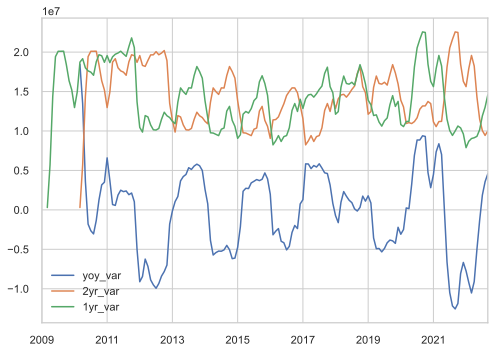

In [93]:
# Plotting Variance variables against one another
dfM['yoy_var'].plot(legend=True)
dfM['2yr_var'].plot(legend=True)
dfM['1yr_var'].plot(legend=True)

We can see from the above visual that the orange and green lines are similar and out of sync from one another with a one year lag. 
Upon subtracting them from each other (differencing), the blue line has been standardised about the X axis. The reason we wont call this stationarised is because the yoy variance change is not consistent.

This is important as it tells us a few things:
- It tells us that the change between the peaks and troughs of the seasonal changes are generally converging (variance is reducing) with the exception of 2020 
- 2020 had the biggest change in variance due to the out of the ordinary drop in energy demand in the 2020 COVID summers

## Correlations

We want to identify potential causailty between different features in our datset. One way to do this is to plot a correlation matrix with a heatmap, making it intuitive to visually identify high correlations

In [94]:
# We can scale the data to later visualise the different correlating features and better understand just how correlated they are: 
from sklearn.preprocessing import StandardScaler

stdsclr = StandardScaler() 

dfM_scld = pd.DataFrame(stdsclr.fit_transform(dfM),columns=dfM.columns,index=dfM.index)

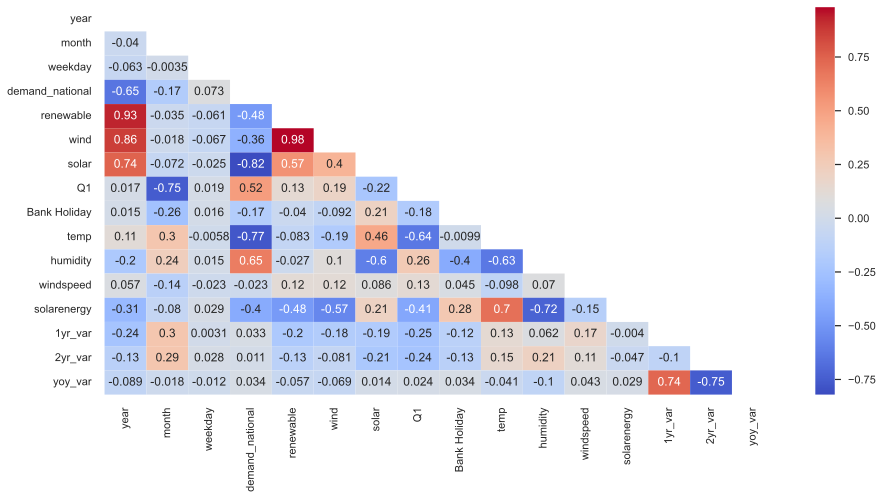

In [95]:
# find the correlation between the variables
corr = dfM_scld.corr()

# plot the correlation matrix using a heatmap
plt.figure(figsize=(15,7))
matrix = np.triu(dfM_scld.corr())
sns.heatmap(corr, annot=True, mask=matrix, cmap='coolwarm')
plt.show()

The above visualisation tells us a lot bout the relationship between all the features. We place as much value on the positive and negative values, with a focus on the values that have a high absolute correlation. Our main focus for this exercise is to identify potential correlations between the fetatures we have engineered and our energy demand data and renewable gen data. We know that the renewable data is an aggregate of the solar and wind data, so any correlation between those variables and the features engineered will be an indicator of a causality for our renewable gen data. In order to be able to visualise the correlations we have scaled the data down.

### Demand - Correlations

#### Temperature - Demand

From previous EDA we were able to identify that there was a clear seasonality in the demand data, whereby energy consumption would drop significantly during seasons of higher temperatures. This can be attributed to a number of factors:

- Lowered population, therefore consumption as people travel for the summer months in line with school holidays
- Less need for electric heating 
- People are generally out more during these months as the daylight hours are longer, therefore they are less likely to consume energy domestically
- People are less likely to take hot showers

<AxesSubplot:title={'center':'National Energy Demand & Temperature (Scaled)'}, xlabel='Years'>

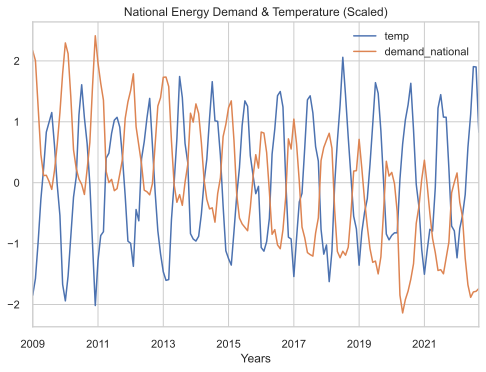

In [96]:
dfM_scld['temp'].plot(legend=True,title='National Energy Demand & Temperature (Scaled)',xlabel='Years')
dfM_scld['demand_national'].plot(legend=True)

#### Humidity - Demand

Humidity and National Demand have a high positive correlation, one explanation for this could be that there is an increased (and decreased) amount of energy spent on cooling systems to counteract the effects of humidity on the populous as well as in industrial processing facilities that require humidity control solutions to ensure the optimal quality of the final product.

Another explanation could be the relationship between Humidity and precipitation, whereby the higher the humidity the more it rains. Rain is more prevalent in the colder months which we know are the months with the highest demand. This relationship most likely is not causal, whereby it may just be coincidental that both follow a similar seasonal trend due to sensitivities to climate.

<AxesSubplot:title={'center':'National demand & Humidity (Scaled)'}>

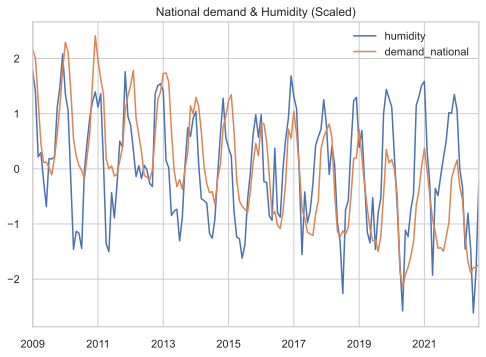

In [97]:
dfM_scld['humidity'].plot(legend=True,title='National demand & Humidity (Scaled)')
dfM_scld['demand_national'].plot(legend=True)

### Renewables - Correlations

#### Renewable - Solar Energy

There is a clear negative correlation between Solar Energy and Renewable Energy gen. If we look at both wind and solar, we can see that this is mainly attributed to the negative correlation between wind & solar energy. With solar energy being positively correlated to Solar Energy, offsetting its impact on Total Renewable gen.

While it is hard to explain why this isn't the case without specific domain expertise in geophysics, we are able to conclude that wind generation drops in times of high solar energy recordings.

<AxesSubplot:title={'center':'National demand & Solar Energy'}>

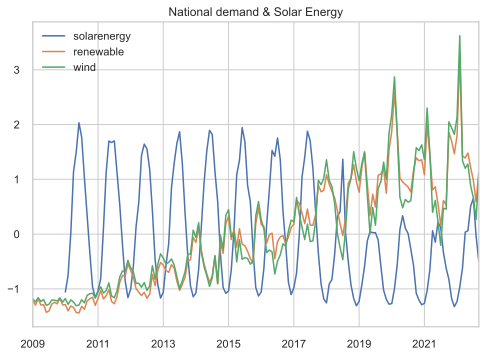

In [98]:
dfM_scld['solarenergy'].plot(legend=True,title='National demand & Solar Energy')
dfM_scld['renewable'].plot(legend=True)
dfM_scld['wind'].plot(legend=True)

# Modelling

## Holt-winters Exponential Smoothing

In [99]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing

In this stage we will be using the Holt-winters exponential smoothing method to forecast.

###  Test Train Split

We will begin by splitting the data into a test train slices. The training set will be what the model will analyze to predict into the future, the test set is what we will be using to compare against and evaluate the model's success.

In [100]:
demand.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 165 entries, 2009-01-31 to 2022-09-30
Freq: M
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   demand_national  165 non-null    float64
 1   3-month-SMA      163 non-null    float64
 2   6-month-SMA      160 non-null    float64
 3   12-month-SMA     154 non-null    float64
dtypes: float64(4)
memory usage: 6.4 KB


We know there are 165 rows in the target (demand_national) column. As such a 75% - 25% split would mean a split before and after the 123rd row:

In [101]:
train_data = dfM.iloc[:124]
test_data = dfM[123:]

### Additive - Approach

Additive decomposition: Time series data is a function of the total of its parts. We can usually identify an additive time series from its consistent variance over time. The behaviour in the additive model is linear, meaning that changes are continually produced in the same direction throughout time, much like a linear trend. In this instance, the frequency and amplitude of the linear seasonality are equal throughout.

Earlier we plotted the rolling 1 year variance over time for demand_national data. We observed that the variance was not stationary over time. Therefore we know that this model is a multiplicative one, below we will test this out by making both an additive model and a multiplicative one for comparison.

####  Train Model

For HW there are a few parameters we can tune, for simplicity we will tuning only the necessary parameters. Additive trend denotes a linear (straight line) trend, and additive seasonality denotes that the widths or heights of seasonal periods do not alter over time.

In [102]:
fitted_model = ExponentialSmoothing(train_data['demand_national'],
                                   trend='add', 
                                   seasonal='add',
                                   seasonal_periods=12, # 12 months in a seasonal cycle
                                   freq='M' # Months 
                                   ).fit()

#### Prediction

In [103]:
es_add_pred = fitted_model.forecast(42) # forecasting 42 months ahead (lenght of the test set)

<AxesSubplot:title={'center':'Exponential Smoothing - Additive'}>

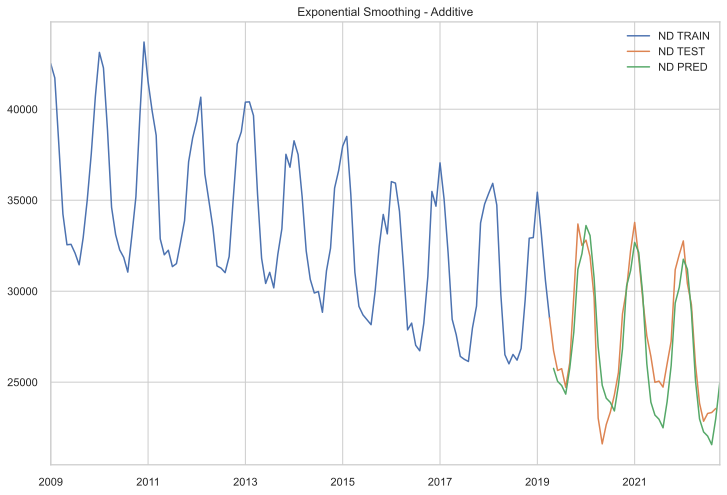

In [104]:
train_data['demand_national'].plot(legend=True,label='ND TRAIN',figsize=(12,8),title='Exponential Smoothing - Additive')
test_data['demand_national'].plot(legend=True,label='ND TEST')
es_add_pred.plot(legend=True,label='ND PRED')


In the above graph we can see that while the predicition's peaks are moving in line with that of the test data, the troughs are not as tightly aligned. This is most likely due to the additive model assuming that the amplitudes of the seasonal component are constant.

<AxesSubplot:>

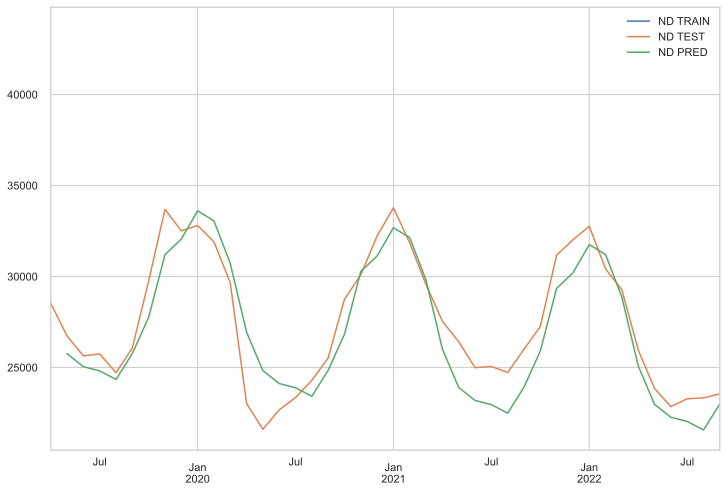

In [105]:
train_data['demand_national'].plot(legend=True,label='ND TRAIN',figsize=(12,8))
test_data['demand_national'].plot(legend=True,label='ND TEST')
es_add_pred.plot(legend=True,label='ND PRED',xlim=["2019-04-30",'2022-09-30'])

Above we take a snapshot of the test data only. We can see here very clearly how the prediction struggles to predict the significant drop caused by COVID in the summer of 2020

In [106]:
#recreat eusing seaborn

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_data.index, y=train_data['demand_national'], mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test_data.index, y=test_data['demand_national'], mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=es_add_pred.index, y=es_add_pred, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title="Exponential Smoothing Prediction - Additive"
)
fig.show()

Above we recreate the graph using an interactive Seaborn graph

#### Model Evaluation

In [107]:
from sklearn.metrics import mean_squared_error,mean_absolute_error

In [108]:
display(test_data['demand_national'].describe())

count       42.000000
mean     27500.371992
std       3581.851120
min      21610.885081
25%      24722.225638
50%      26575.367944
75%      30340.567225
max      33777.479839
Name: demand_national, dtype: float64

##### Absolute Error

Without taking into account their direction, MAE calculates the average size of the mistakes in a collection of forecasts. All individual errors are equally weighted in the test sample's average of the absolute disparities between prediction and observation.

In [109]:
add_ae = mean_absolute_error(test_data['demand_national'],es_add_pred)
add_ae

1602.049902257373

Absolute Error is less than standard deviation of overall data, this tells us the model didn't perform too badly

##### Root Mean Squared

Root mean squared error (RMSE) is a scoring formula for quadratic equations that also calculates the average error magnitude. It is the average of the squared discrepancies between predicted results and actual observations.

In [110]:
np.sqrt(mean_squared_error(test_data['demand_national'],es_add_pred))

1876.0616399222547

#### MAPE

The most popular method for estimating error is called the mean absolute percentage error (MAPE), presumably because it is the easiest to comprehend since the variable's units are scaled to percentages. If the data don't have any extremes, it works best (and no zeros). In the assessment of models and regression analyses, it is often used as a loss function. 

Moving forward we will exclusively use MAPE as our evaluation technique due to to easy it is to cenceptualise

In [111]:
add_test_mape = mean_absolute_percentage_error(test_data['demand_national'],es_add_pred)

print(f"Test MAPE on the difference: {round(add_test_mape*100, 3)}%")

Test MAPE on the difference: 5.899%


In [112]:
#building a dictionary of MAPE values for comparison later
me = {'HW_add':round(add_test_mape*100, 3)}
me

{'HW_add': 5.899}

The prediction is deemed to be sufficiently accurate if the MAPE is less than 5%. A MAPE of more than 10% but less than 25% implies low accuracy; while a MAPE of more than 25% indicates extremely poor accuracy levels so low that the prediction is not acceptable.

In our case there is an inflection point within the test set, this is hindering our ability to accurately evaluate the models' capability of forecasting into the future (out of our dataset). This means we can be less stringent about where the MAPE falls relative to the industry defined thresholds, and focus more on reducing it as much as possible. 

### Multiplicative Approach

This model implies that the seasonal pattern grows along with the data. Such a trend may be seen in the majority of time series plots. The trend and seasonal components in this model are multiplied before being combined with the error component.

From our EDA we know that the trend is linear, so we will maintain that the trend is additive in this next model. However we have already ascertained that the seasonal component of the data has inconsistent variance. As such we will change the seasonal parameter to 'mul' (multiplicative). 

#### Train Model

In [113]:
fitted_model = ExponentialSmoothing(train_data['demand_national'],
                                   trend='add', #additive
                                   seasonal='mul', #multiplicative
                                   seasonal_periods=12, # 12 months in a seasonal cycle
                                   freq='M' # Months 
                                   ).fit()

/Users/jad/opt/anaconda3/envs/main/lib/python3.10/site-packages/statsmodels/tsa/holtwinters/model.py:915: ConvergenceWarning:

Optimization failed to converge. Check mle_retvals.



#### Prediction

In [114]:
es_mul_pred = fitted_model.forecast(42)

<AxesSubplot:>

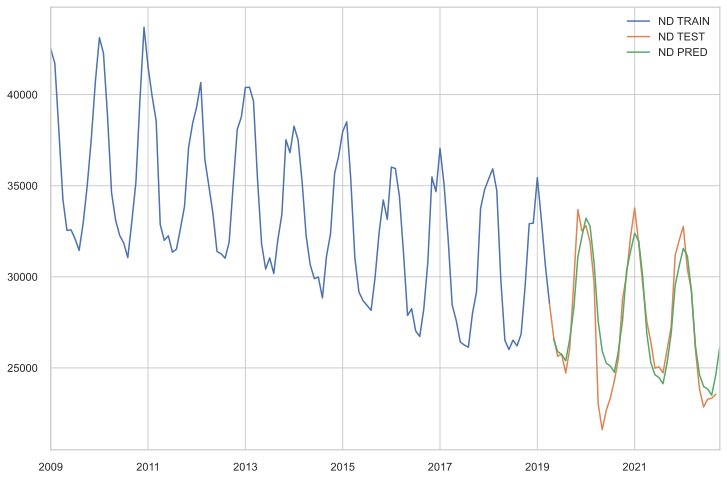

In [115]:
train_data['demand_national'].plot(legend=True,label='ND TRAIN',figsize=(12,8))
test_data['demand_national'].plot(legend=True,label='ND TEST')
es_mul_pred.plot(legend=True,label='ND PRED')


From the above visual we can see that the multiplicative seasonal component has reduced the overall amplitude of the seasonal component and forced it closer to the troughs of the test set. 

We have accepted that the COVID summer is an anomaly that will be impossible to predict without introducing an exogenous regressor that can account for the drop. That said, the forecast has done quite well to capture the general trend and seasonality of the timeseries data. 

<AxesSubplot:>

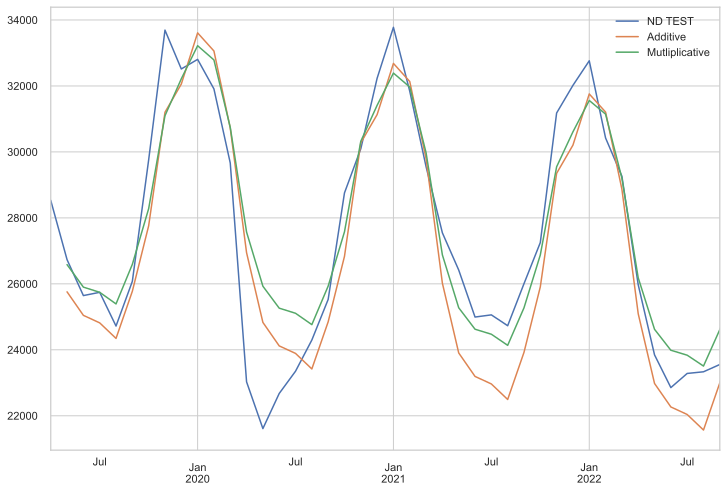

In [116]:
test_data['demand_national'].plot(legend=True,label='ND TEST',figsize=(12,8))
es_add_pred.plot(legend=True,label='Additive',xlim=["2019-04-30",'2022-09-30'])
es_mul_pred.plot(legend=True,label='Mutliplicative',xlim=["2019-04-30",'2022-09-30'])


Above we plot the additive and multiplicate approaches overlaid with the test data to visually compare their accuracy.

We can see that:
- The multiplicative model has tighter fit (lower amplitudes) about the trend line compared with the additive model
- For 2021 & 2022 the multiplicative approach comes much closer to predicting the troughs of the data 
- The additive performs slightly better when comparing with the peaks of the seasonal component
- While both have identical seasonal components appended about the trend over time, the multiplicative model takes into consideration the changing variance over time

In [117]:
test_data.head(5)

,year,month,weekday,demand_national,renewable,wind,solar,Q1,Bank Holiday,temp,humidity,windspeed,solarenergy,1yr_var,2yr_var,yoy_var
2019-04-30,2019.0,4.0,0.600000,28529.799306,8253.011806,6092.740972,1883.795139,0.0,0.500000,10.676667,66.560000,20.316667,9.806667,1.204524e+07,1.696756e+07,-4.922322e+06
2019-05-31,2019.0,5.0,0.580645,26732.215726,6283.024194,4012.788306,2092.772177,0.0,0.451613,13.422581,65.141935,18.954839,11.041935,1.113008e+07,1.602298e+07,-4.892906e+06
2019-06-30,2019.0,6.0,0.533333,25643.747222,7597.830556,5411.113889,1919.975000,0.0,0.000000,16.620000,71.133333,20.630000,10.893333,1.061739e+07,1.593998e+07,-5.322586e+06
2019-07-31,2019.0,7.0,0.612903,25742.460349,6820.305108,4477.296371,2065.005376,0.0,0.000000,19.951613,64.277419,18.703226,10.896774,1.128980e+07,1.617765e+07,-4.887849e+06
2019-08-31,2019.0,8.0,0.548387,24719.801747,8752.656586,6415.055108,1930.357527,0.0,0.225806,19.100000,69.070968,21.590323,9.929032,1.165266e+07,1.582093e+07,-4.168270e+06


In [118]:
# Plotting with seaborn

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_data.index, y=train_data['demand_national'], mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test_data.index, y=test_data['demand_national'], mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=es_mul_pred.index, y=es_mul_pred, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title="Exponential Smoothing - Multiplicative"
)
fig.show()

Above we recreate the graph using an interactive Seaborn graph

#### Model Evaluation

In [119]:
from sklearn.metrics import mean_squared_error,mean_absolute_error

#### MAPE

In [120]:
mul_test_mape = mean_absolute_percentage_error(test_data['demand_national'],es_mul_pred)

print(f"Test MAPE on the difference: {round(mul_test_mape*100, 3)}%")

Test MAPE on the difference: 5.388%


In [121]:
#Updating Model Evaluation Dictionary
me['HW_mul'] = round(mul_test_mape*100, 3)

In [122]:
me

{'HW_add': 5.899, 'HW_mul': 5.388}

Absolute Error is less than standard deviation of overall data

In [123]:
print(f" The Multiplicate MAPE was {round(round(mul_test_mape*100, 3)-round(add_test_mape*100, 3),3)}% better at predicting the test set than the Additive model")

 The Multiplicate MAPE was -0.511% better at predicting the test set than the Additive model


## Stationarization

In [124]:
# Differencing the 
demand["seasonal_difference"] = demand["demand_national"].diff(12)

In [125]:
demand["seasonal_difference"]

2009-01-31            NaN
2009-02-28            NaN
2009-03-31            NaN
2009-04-30            NaN
2009-05-31            NaN
                 ...     
2022-05-31   -2572.522849
2022-06-30   -2139.215972
2022-07-31   -1776.113575
2022-08-31   -1396.599462
2022-09-30   -2450.076389
Freq: M, Name: seasonal_difference, Length: 165, dtype: float64

<AxesSubplot:>

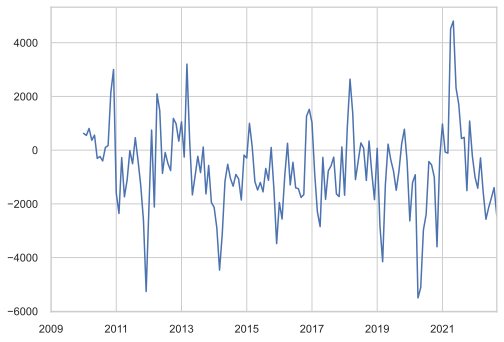

In [126]:
demand["seasonal_difference"].plot()

In [127]:
fitted_model = ExponentialSmoothing(train_data['demand_national'],
                                   trend='mul',
                                   seasonal='mul',
                                   seasonal_periods=12).fit()

/Users/jad/opt/anaconda3/envs/main/lib/python3.10/site-packages/statsmodels/tsa/holtwinters/model.py:915: ConvergenceWarning:

Optimization failed to converge. Check mle_retvals.



### Dicky Fuller Stats Test

We can use the Augmented Dicky Fuller (ADF) test to test for Stationarity. 

Te null hypothesis assumes that a unit root exists, the presence of a unit root tells us that the data can be differenced again to become stationary. 

The ADF test's p-value must be smaller than the significance level (0.05) in order to reject the null hypothesis since the null hypothesis implies the existence of a unit root. resulting in the conclusion that the series is stationary.

In [128]:
from statsmodels.tsa.stattools import adfuller

In [129]:
dftest = adfuller(demand["seasonal_difference"].dropna())
dfout = pd.Series(dftest[0:4], index=['ADF Test Statistic','p-value','# Lags used','# Observations'])
dfout

ADF Test Statistic     -4.159049
p-value                 0.000772
# Lags used            12.000000
# Observations        140.000000
dtype: float64

We see above from our results that the p value is much lower than our defined 5% significance level, therefore we may reject the null hypothesis that there is a unit root present in seasonal difference and we have successfully stationarized the data 

## AR Model

In [130]:
from statsmodels.tsa.ar_model import AutoReg,ARResults

In [131]:
model = AutoReg(train_data['demand_national'], lags=12)

In [132]:
arima = pd.DataFrame(demand["seasonal_difference"].iloc[12:,])

In [133]:
sdtrain_data = arima.iloc[:115]
sdtest_data = arima[114:]

In this section we will be creative an AR (auto regression) model. 

### Autocorrelation

First off we will create the partial autocorrelation function (PACF) and the autocorrelation function (ACF). These are crucial for choosing the appropriate model for predicting in time series analysis. They can help us select model orders such as p for AR (and q for MA). 

#### ACF

Below we plot the Autocorrelation Function:

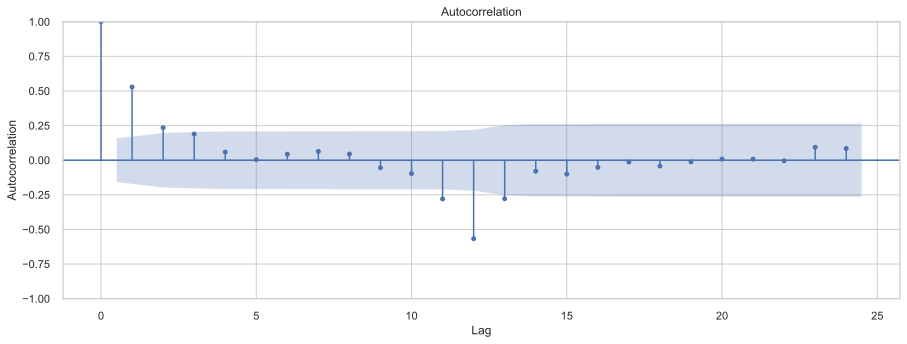

In [134]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plt.figure(figsize=(15, 5))
plot_acf(demand["seasonal_difference"].dropna(), lags=24, ax=plt.gca())
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

#### PACF

Below we plot the Partial Autocorrelation Function:

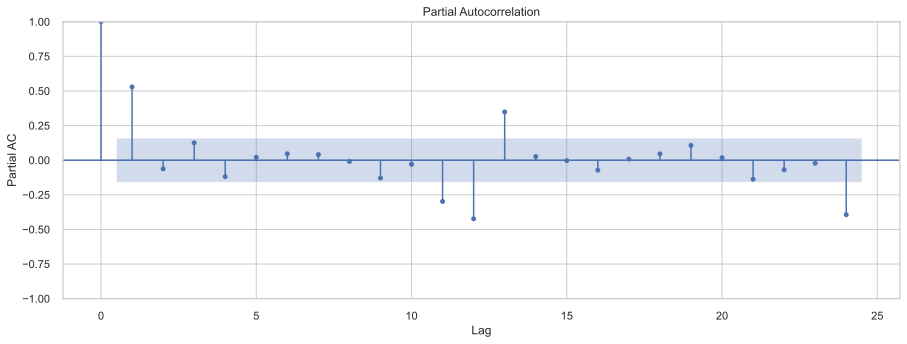

In [135]:
plt.figure(figsize=(15, 5))
plot_pacf(demand["seasonal_difference"].dropna(), lags=24, ax=plt.gca(), method='ywm')
plt.xlabel('Lag')
plt.ylabel('Partial AC')
plt.show()

#### Analysis - ACF & PACF

From the ACF we can see a clear Tail off pattern, this is indicative of the need for an AR model. 
From PACF, cut off happens at lag 1. Thus, the order is 1. So it should be AR(1) model.


In [136]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

### Deciding our model parameters

Below we will be using the differenced (stationarised) data. The model we are creating is a simple AR model so the 'p' parameter will be order 1; since we won't use an MA component in this model 'q' will be 0, and since we have already differenced it we don't need to add in a 'd' parameter.

order = (p,d,q) = (1,0,0)

Since we have removed the trend component by differencing, we can define the trend component as 'c', where ‘c’ indicates a constant (i.e. a degree zero component of the trend polynomial).

### Fitting Model

In [137]:
model = SARIMAX(sdtrain_data['seasonal_difference'],order=(1,0,0), trend="c") 
result = model.fit(disp=0) # Hide convergence info with disp

In [138]:
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                SARIMAX Results                                
===============================================================================
Dep. Variable:     seasonal_difference   No. Observations:                  115
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -985.466
Date:                 Wed, 09 Nov 2022   AIC                           1976.933
Time:                         12:00:23   BIC                           1985.168
Sample:                     01-31-2010   HQIC                          1980.275
                          - 07-31-2019                                         
Covariance Type:                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept   -384.7556    134.478     -2.861      0.004    -648.328    -121.184
ar.L1          0.4391      0.077      5.668      0.000       0.287       0.591
sigma2      1.623e+06   1.96e+05      8.276      0.000    1.24e+06    2.01e+06
===================================================================================
Ljung-Box (L1) (Q):                   0.17   Jarque-Bera (JB):                 1.20
Prob(Q):                              0.68   Prob(JB):                         0.55
Heteroskedasticity (H):               0.77   Skew:                             0.05
Prob(H) (two-sided):                  0.43   Kurtosis:                         3.49
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

#### Model Summary - Analysis

From the above model summary we want to ensure that every term in our model has statistical significance. As such,  we need all of the terms to have a p-value that is lower than 0.05 in order to reject the null hypothesis which is that the are not statistically significant.

We can see that L1 has a p-value of 0.000 which means that we can reject the null hypothesis that it is not statistically significant, concluding that it is an appropriate inclusion in out model.

In [139]:
start = len(train_data)
end = len(train_data) + len(test_data) - 1

In [140]:
start

124

In [141]:
end

165

In [142]:
print(start)
print(end)

124
165


#### Predicting

Now that we are confident that the model does not have any unnecessary terms, we can use the predict function to model the data into the future. We will do this by predicting ahead through the test set segment.

In [143]:
predictions = result.predict(start-12,end-12).rename('AR Model')

In [144]:
predictions.tail()

2022-06-30   -685.959901
2022-07-31   -685.959901
2022-08-31   -685.959901
2022-09-30   -685.959901
2022-10-31   -685.959901
Freq: M, Name: AR Model, dtype: float64

### Visualizing Prediction

<AxesSubplot:>

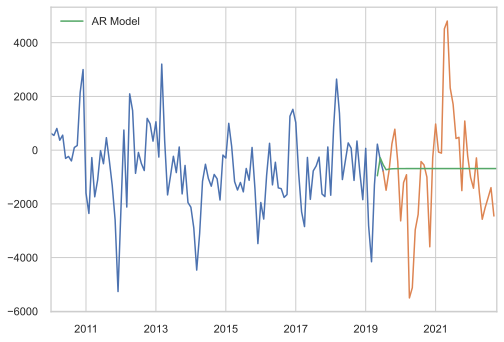

In [145]:
sdtrain_data["seasonal_difference"].plot().plot(legend=True, figsize=(15,8))
sdtest_data["seasonal_difference"].plot().plot(legend=True)
predictions.plot(legend=True)

Please note that with the above prediction we are still attempting to model leftovers according to our seasonal differencing.  We can still make decent predictions for the original series since the trend and seasonal components reflect the majority of the time series' structure.

### Undoing differencing 


By undoing the differencing we did to the original dataset we can restore the seasonal component of our data.

To do this we we start with the original 12 values and always looking back 12 months, we add the difference to get the restored values for the AR prediction

Let's start by isolating what we need, original data and the data we need to restore:

In [146]:
demand_diff = demand[['demand_national','seasonal_difference']]

In [147]:
# use the original train diff values and predicted test values
demand_diff.loc[sdtrain_data.index, "AR_difference"] = demand_diff.loc[sdtrain_data.index, "seasonal_difference"]
demand_diff.loc[sdtest_data.index, "AR_difference"] = predictions[sdtest_data.index]

/var/folders/w6/q0t2llsx3jz_chwg0pf9r0yc0000gn/T/ipykernel_21917/3590044693.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Discrepancies in the index values for the following end of month dates (29th instead o 28th march) were causing issues when inversing the differencing of the fitted model:

Note: These discrepancies were caused by resampling and shouldn't affect the rest of the analysis carried out in the project, as we are not looking at daily granularity

In [148]:
demand_diff.index = demand_diff.index.to_series().replace({pd.Timestamp('2012-02-29'): pd.Timestamp('2012-02-28')})

In [149]:
demand_diff.index = demand_diff.index.to_series().replace({pd.Timestamp('2016-02-29'): pd.Timestamp('2016-02-28')})

In [150]:
demand_diff.index = demand_diff.index.to_series().replace({pd.Timestamp('2020-02-29'): pd.Timestamp('2020-02-28')})

Undoing the differencing of the AR Fitted model:

In [151]:
first_year_indices = demand_diff.index[:12]
remaining_indices = demand_diff.index[12:]

# create empty AR_restored column
demand_diff["AR_restored"] = np.nan

# fill in the first 12 original values from original data
demand_diff.loc[first_year_indices, "AR_restored"] = \
    demand_diff.loc[first_year_indices, "demand_national"]


# use the current difference and 12-month lagged restored value to get the next restored
for current_date in remaining_indices:
    current_value = demand_diff.loc[current_date, "AR_difference"]
    year_before_restored = demand_diff.loc[current_date - pd.DateOffset(months=12), "AR_restored"]
    
    demand_diff.loc[current_date, "AR_restored"] = year_before_restored + current_value


/var/folders/w6/q0t2llsx3jz_chwg0pf9r0yc0000gn/T/ipykernel_21917/105484241.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [152]:
# Plotting the predictions with seabron

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_data.index, y=train_data['demand_national'], mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test_data.index, y=test_data['demand_national'], mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predictions.index, y=demand_diff['AR_restored'].iloc[len(train_data):], mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title="AR Prediction"
)
fig.show()

#### MAPE

In [153]:
AR_und_test_mape = mean_absolute_percentage_error(test_data['demand_national'], demand_diff['AR_restored'].iloc[len(train_data)-1:])

print(f"Test MAPE on the difference: {round(AR_und_test_mape*100, 3)}%")

Test MAPE on the difference: 3.275%


The above model has out performed both Holt-winters models. While it also doesn't account for the large dip we see in 2020, it does a good job matching the seasons' other peaks and troughs. 

In [154]:
me['AR_L1'] = round(AR_und_test_mape*100, 3)

In [155]:
me

{'HW_add': 5.899, 'HW_mul': 5.388, 'AR_L1': 3.275}

## AR Model - Top Down Approach

Below we will be using a top down approach, modeling using many lags and removing the ones that fail to reject the null hypothesis. Where the null hypothesis is that the lag term in our model has statistical significance. 

As a reminder, we need all of the terms to have a p-value that is lower than 0.05 in order to reject the null hypothesis which is that the are not statistically significant.

In [156]:
from statsmodels.tsa.ar_model import AutoReg,ARResults

### Defining test train split

In [157]:
arima = pd.DataFrame(demand["seasonal_difference"].iloc[12:,])

In [158]:
sdtrain_data = demand.iloc[:115]
sdtest_data = demand[114:]

### Deciding optimal lags

##### As we see from above, L1 is the optimal number of lags

In [159]:
AR1fit = AutoReg(train_data['demand_national'], lags=12).fit()

In [160]:
AR1fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            AutoReg Model Results                             
==============================================================================
Dep. Variable:        demand_national   No. Observations:                  124
Model:                    AutoReg(12)   Log Likelihood                -940.600
Method:               Conditional MLE   S.D. of innovations           1074.138
Date:                Wed, 09 Nov 2022   AIC                           1909.200
Time:                        12:00:23   BIC                           1947.259
Sample:                    01-31-2010   HQIC                          1924.641
                         - 04-30-2019                                         
=======================================================================================
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const               -1527.2093   1600.263     -0.954      0.340   -4663.668    1609.250
demand_national.L1      0.5642      0.090      6.294      0.000       0.388       0.740
demand_national.L2     -0.0563      0.103     -0.546      0.585      -0.259       0.146
demand_national.L3   1.614e-05      0.103      0.000      1.000      -0.201       0.201
demand_national.L4     -0.0281      0.103     -0.273      0.785      -0.229       0.173
demand_national.L5     -0.0355      0.103     -0.347      0.729      -0.236       0.165
demand_national.L6     -0.0084      0.103     -0.081      0.935      -0.210       0.193
demand_national.L7     -0.0710      0.103     -0.691      0.490      -0.272       0.130
demand_national.L8      0.2304      0.103      2.235      0.025       0.028       0.432
demand_national.L9     -0.1679      0.105     -1.600      0.110      -0.374       0.038
demand_national.L10     0.1377      0.106      1.295      0.195      -0.071       0.346
demand_national.L11     0.1503      0.106      1.413      0.158      -0.058       0.359
demand_national.L12     0.3190      0.091      3.496      0.000       0.140       0.498
                                    Roots                                     
==============================================================================
                   Real          Imaginary           Modulus         Frequency
------------------------------------------------------------------------------
AR.1             0.9948           -0.0000j            0.9948           -0.0000
AR.2             0.8684           -0.5024j            1.0033           -0.0835
AR.3             0.8684           +0.5024j            1.0033            0.0835
AR.4             0.5624           -0.9120j            1.0714           -0.1621
AR.5             0.5624           +0.9120j            1.0714            0.1621
AR.6            -0.0018           -1.0818j            1.0818           -0.2503
AR.7            -0.0018           +1.0818j            1.0818            0.2503
AR.8            -1.0828           -0.0000j            1.0828           -0.5000
AR.9            -0.9607           -0.7141j            1.1971           -0.3983
AR.10           -0.9607           +0.7141j            1.1971            0.3983
AR.11           -0.6599           -1.0326j            1.2254           -0.3405
AR.12           -0.6599           +1.0326j            1.2254            0.3405
------------------------------------------------------------------------------
"""

From the above summary we can see that L1, L8 & L12 are all statistically significant and fail to reject the null hypothesis. That said, we can see that L1 & L12 are much more likely to reject the null hypothesis so we will compare these with one another.

### MAPE

#### L12

In [161]:
AR12fit = AutoReg(train_data['demand_national'], lags=[12]).fit()

In [162]:
predict_ARL12 = AR1fit.predict(start=start,end=end)

In [163]:
predict_AR_L12 = mean_absolute_percentage_error(test_data['demand_national'],predict_ARL12)

print(f"Test MAPE on the L12: {round(predict_AR_L12*100, 3)}%")


Test MAPE on the L12: 6.72%


In [164]:
me['AR_L12'] = round(predict_AR_L12*100, 3)

#### [L1, L12]

In [165]:
AR112fit = AutoReg(train_data['demand_national'], lags=[1,12]).fit()

In [166]:
model_AR_L112 = AR112fit.predict(start=start,end=end)

In [167]:
predict_AR_L112 = mean_absolute_percentage_error(test_data['demand_national'],model_AR_L112)

print(f"Test MAPE on the [L1,L12] model: {round(predict_AR_L112*100, 3)}%")

Test MAPE on the [L1,L12] model: 4.379%


In [168]:
me['AR_L11,12'] = round(predict_AR_L112*100, 3)

We can see above that neither model performs as well as (lower MAPE) the L1 model we manually plotted earlier. We do however see that the [L1, L12] model performs better than the L12 model, which is probably due to the inclusion of the L1 term

In [169]:
me

{'HW_add': 5.899,
 'HW_mul': 5.388,
 'AR_L1': 3.275,
 'AR_L12': 6.72,
 'AR_L11,12': 4.379}

### AR [L1, 12] Model Visualised

<AxesSubplot:title={'center':'AR Prediction'}>

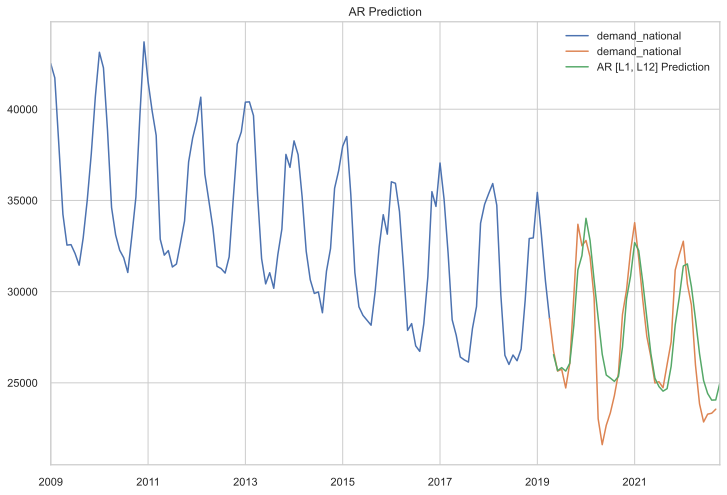

In [170]:
train_data['demand_national'].plot(figsize=(12,8),title= "AR Prediction", legend=True)
test_data['demand_national'].plot(legend=True)
model_AR_L112.plot(legend=True,label='AR [L1, L12] Prediction')

In [171]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train_data.index, y=train_data['demand_national'], mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test_data.index, y=test_data['demand_national'], mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=model_AR_L112.index, y=model_AR_L112, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Year",
    title="AR [L1, L12] Prediction"
)
fig.show()

## Using AutoArima

In this section we will use auto ARIMA to isolate the best combination of parameters in order to minimise our MAPE as much as possible. AutoArima has two main types of ways of isolating the optimal parameters, one is th Random Search method and the other is the Grid Search method. Both will reap good results but in theory the grid search should find the optimal result because it will try every possible combination. Below we will try both and compare the MAPE values for both.

### AutoArima - Random Search

We have been manually fitting many models to data and trying to select the most effective one up until now. 

In the next model we will automate the procedure using AutoArima. In essence, AutoArima starts with the data and fits several models in a different sequence, then evaluates the models using AIC and compares to find the model with the lowest AIC value.

The Akaike information criterion (AIC) is an estimator of out-of-sample prediction error and thereby relative quality of statistical models for a given set of data. Given a collection of models for the data, AIC estimates the quality of each model, relative to each of the other models. Thus, AIC provides a means for model selection. — Wikipedia



#### Splitting Data

In [172]:
train = demand['demand_national'].iloc[:124]
test = demand['demand_national'].iloc[123:]

#### Random search method

The Random search method is a much less computationally exhaustive technique as it doesn't try every single combination of the order & seasonal order. But it generally will reap a good result much faster.

In [173]:
model_autoarima = auto_arima(train, 
                        m=12, seasonal=True, # m= 12 months in a year/season
                      start_p=0, start_q=0, max_order=4, test='adf',error_action='ignore',  # Setting minimum and maximum values we would like to ir=terate through for each param
                           suppress_warnings=True, # Ignores warnings during search
                      stepwise=True, # Stepwise = True sets it to RANDOM search to save time
                             trace=True) # Shows step by step model creation and evaluation
#m = 12 as data contains monthly observations

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(1,0,1)[12] intercept   : AIC=2372.093, Time=0.14 sec
 ARIMA(0,0,0)(0,0,0)[12] intercept   : AIC=2428.414, Time=0.01 sec
 ARIMA(1,0,0)(1,0,0)[12] intercept   : AIC=2199.513, Time=0.10 sec
 ARIMA(0,0,1)(0,0,1)[12] intercept   : AIC=2249.442, Time=0.12 sec
 ARIMA(0,0,0)(0,0,0)[12]             : AIC=2939.733, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[12] intercept   : AIC=2262.235, Time=0.01 sec
 ARIMA(1,0,0)(2,0,0)[12] intercept   : AIC=2167.669, Time=1.23 sec
 ARIMA(1,0,0)(2,0,1)[12] intercept   : AIC=inf, Time=1.62 sec
 ARIMA(1,0,0)(1,0,1)[12] intercept   : AIC=2171.359, Time=0.29 sec
 ARIMA(0,0,0)(2,0,0)[12] intercept   : AIC=2422.818, Time=0.87 sec
 ARIMA(2,0,0)(2,0,0)[12] intercept   : AIC=2182.132, Time=1.29 sec
 ARIMA(1,0,1)(2,0,0)[12] intercept   : AIC=2146.145, Time=2.07 sec
 ARIMA(1,0,1)(1,0,0)[12] intercept   : AIC=2156.262, Time=0.25 sec
 ARIMA(1,0,1)(2,0,1)[12] intercept   : AIC=2177.829, Time=1.84 sec
 ARIMA(1,0,1)(1,0,1)[12]

#### Model fit

In [174]:
model = SARIMAX(train,order=(1,0,2),seasonal_order=(1, 0, 1, 12)) #(AR,Diff,MA,Period Season)
model_fit = model.fit(disp=0)
predict2 = model_fit.predict(start,end).rename('AutoArima Model')

model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:                      demand_national   No. Observations:                  124
Model:             SARIMAX(1, 0, 2)x(1, 0, [1], 12)   Log Likelihood               -1055.273
Date:                              Wed, 09 Nov 2022   AIC                           2122.546
Time:                                      12:01:04   BIC                           2139.468
Sample:                                  01-31-2009   HQIC                          2129.420
                                       - 04-30-2019                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000   2.69e-06   3.71e+05      0.000       1.000       1.000
ma.L1         -0.4111      0.086     -4.776      0.000      -0.580      -0.242
ma.L2         -0.4956      0.089     -5.572      0.000      -0.670      -0.321
ar.S.L12       0.9862      0.009    108.182      0.000       0.968       1.004
ma.S.L12      -0.6506      0.101     -6.434      0.000      -0.849      -0.452
sigma2      1.117e+06   1.65e-08   6.77e+13      0.000    1.12e+06    1.12e+06
===================================================================================
Ljung-Box (L1) (Q):                   0.15   Jarque-Bera (JB):                 2.29
Prob(Q):                              0.70   Prob(JB):                         0.32
Heteroskedasticity (H):               0.66   Skew:                             0.26
Prob(H) (two-sided):                  0.19   Kurtosis:                         3.42
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 1.51e+29. Standard errors may be unstable.
"""

In [175]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=train, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test.index, y=test, mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predict2.index, y=predict2, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title="AutoArima Prediction - Demand Data"
)
fig.show()

#### MAPE

In [176]:
predict_autoR = mean_absolute_percentage_error(test_data['demand_national'], predict2)

print(f"Test MAPE on the AutoArima model: {round(predict_autoR*100, 2)}%")

Test MAPE on the AutoArima model: 5.71%


In [177]:
me['AutoAr_Random'] = round(predict_autoR*100, 3)

### AutoArima - Grid Search

#### Grid search method

The grid search method is a more robust technique because it will try every single combination (within the limitations set) of the order & seasonal order. It will find the model with the lowest AIC value.

In [178]:
model_autoarima = auto_arima(train, 
                        m=12, seasonal=True, # m= 12 months in a year/season
                      start_p=0, start_q=0, max_order=4, test='adf',error_action='ignore',  # Setting minimum and maximum values we would like to ir=terate through for each param
                           suppress_warnings=True, # Ignores warnings during search
                      stepwise=False, # Stepwise = True sets it to GRID search to save time
                             trace=True) # Shows step by step model creation and evaluation
#m = 12 as data contains monthly observations

 ARIMA(0,0,0)(0,0,0)[12] intercept   : AIC=2428.414, Time=0.02 sec
 ARIMA(0,0,0)(0,0,1)[12] intercept   : AIC=2336.707, Time=0.14 sec
 ARIMA(0,0,0)(0,0,2)[12] intercept   : AIC=inf, Time=0.68 sec
 ARIMA(0,0,0)(1,0,0)[12] intercept   : AIC=2429.116, Time=0.04 sec
 ARIMA(0,0,0)(1,0,1)[12] intercept   : AIC=2372.093, Time=0.11 sec
 ARIMA(0,0,0)(1,0,2)[12] intercept   : AIC=2359.124, Time=0.82 sec
 ARIMA(0,0,0)(2,0,0)[12] intercept   : AIC=2422.818, Time=0.60 sec
 ARIMA(0,0,0)(2,0,1)[12] intercept   : AIC=inf, Time=1.06 sec
 ARIMA(0,0,0)(2,0,2)[12] intercept   : AIC=inf, Time=1.52 sec
 ARIMA(0,0,1)(0,0,0)[12] intercept   : AIC=2321.680, Time=0.04 sec
 ARIMA(0,0,1)(0,0,1)[12] intercept   : AIC=2249.442, Time=0.11 sec
 ARIMA(0,0,1)(0,0,2)[12] intercept   : AIC=inf, Time=0.83 sec
 ARIMA(0,0,1)(1,0,0)[12] intercept   : AIC=2352.006, Time=0.06 sec
 ARIMA(0,0,1)(1,0,1)[12] intercept   : AIC=2333.822, Time=0.14 sec
 ARIMA(0,0,1)(1,0,2)[12] intercept   : AIC=2222.216, Time=1.26 sec
 ARIMA(0,0,1)(2

#### Model fit

In [179]:
model = SARIMAX(train,order=(1,0,1),seasonal_order=(2, 0, 0, 12)) #(AR,Diff,MA,Period Season)
model_fit = model.fit(disp=0)
predict3 = model_fit.predict(start,end).rename('AutoArima Model')

model_fit.summary()

/Users/jad/opt/anaconda3/envs/main/lib/python3.10/site-packages/statsmodels/base/model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                     demand_national   No. Observations:                  124
Model:             SARIMAX(1, 0, 1)x(2, 0, [], 12)   Log Likelihood               -1062.846
Date:                             Wed, 09 Nov 2022   AIC                           2135.692
Time:                                     12:01:30   BIC                           2149.794
Sample:                                 01-31-2009   HQIC                          2141.421
                                      - 04-30-2019                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9753      0.012     80.402      0.000       0.952       0.999
ma.L1         -0.3753      0.087     -4.328      0.000      -0.545      -0.205
ar.S.L12       0.3679      0.068      5.432      0.000       0.235       0.501
ar.S.L24       0.5931      0.070      8.485      0.000       0.456       0.730
sigma2      1.231e+06   1.77e+05      6.962      0.000    8.84e+05    1.58e+06
===================================================================================
Ljung-Box (L1) (Q):                   0.21   Jarque-Bera (JB):                 0.60
Prob(Q):                              0.65   Prob(JB):                         0.74
Heteroskedasticity (H):               0.80   Skew:                             0.09
Prob(H) (two-sided):                  0.48   Kurtosis:                         2.71
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [180]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=train, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test.index, y=test, mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predict3.index, y=predict3, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title="AutoArima Prediction - Demand Data"
)
fig.show()

#### MAPE

In [181]:
predict_autoG = mean_absolute_percentage_error(test_data['demand_national'], predict3)

print(f"Test MAPE on the AutoArima model: {round(predict_autoG*100, 2)}%")

Test MAPE on the AutoArima model: 5.7%


In [182]:
me['AutoAr_Grid'] = round(predict_autoG*100, 3)

## SARIMAX - Implicit differencing¶

Taking what we have learned from the grid search from AutoArima, we can no attempt to predict using the Implicit Differencing method with SARIMAX.

#### Fitting model

In [183]:
# Fitting model using the optimal order params from the grid search conducted using autoarima

p_param = 1 # We know from the ACF graph that this is a AR(1) model, this is supported by the Grid Search result
d_param = 0 # We know from the autocrrelation grid search that the data is stationary and doesnt need differencing
q_param = 1 # Inclusion of a moving average component

model = SARIMAX(train, order=(p_param, d_param, q_param), seasonal_order = (2,0,0,12)) # Seasonal order = (AR = (Lag 2),Diff = (0),MA = (0),Period Season)
model_fit = model.fit(disp=0)
predict = model_fit.predict()

model_fit.summary()

/Users/jad/opt/anaconda3/envs/main/lib/python3.10/site-packages/statsmodels/base/model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                     demand_national   No. Observations:                  124
Model:             SARIMAX(1, 0, 1)x(2, 0, [], 12)   Log Likelihood               -1062.846
Date:                             Wed, 09 Nov 2022   AIC                           2135.692
Time:                                     12:01:31   BIC                           2149.794
Sample:                                 01-31-2009   HQIC                          2141.421
                                      - 04-30-2019                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9753      0.012     80.402      0.000       0.952       0.999
ma.L1         -0.3753      0.087     -4.328      0.000      -0.545      -0.205
ar.S.L12       0.3679      0.068      5.432      0.000       0.235       0.501
ar.S.L24       0.5931      0.070      8.485      0.000       0.456       0.730
sigma2      1.231e+06   1.77e+05      6.962      0.000    8.84e+05    1.58e+06
===================================================================================
Ljung-Box (L1) (Q):                   0.21   Jarque-Bera (JB):                 0.60
Prob(Q):                              0.65   Prob(JB):                         0.74
Heteroskedasticity (H):               0.80   Skew:                             0.09
Prob(H) (two-sided):                  0.48   Kurtosis:                         2.71
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

#### Predict

In [184]:
predict_id = model_fit.predict(start=0, end=len(train)+len(test)-1)

In [185]:
predict_id

2009-01-31        0.000000
2009-02-28    41994.807129
2009-03-31    41684.206347
2009-04-30    39508.036702
2009-05-31    36708.336256
                  ...     
2022-06-30    23607.563288
2022-07-31    23873.893296
2022-08-31    23646.925551
2022-09-30    24566.116010
2022-10-31    26541.396738
Freq: M, Name: predicted_mean, Length: 166, dtype: float64

#### Plotting

In [186]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=train, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test.index, y=test, mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predict_id.index, y=predict_id, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title="SARIMA Prediction - Demand Data"
)
fig.show()

#### MAPE

In [187]:
train_predict_ID = mean_absolute_percentage_error(train, predict_id[train.index])
test_predict_ID = mean_absolute_percentage_error(test, predict_id[test.index])

print(f"Train MAPE on the the Implicit Differencing model: {round(train_predict_ID*100, 2)}%")
print(f"Test MAPE on the Implicit Differencing model is: {round(test_predict_ID*100, 2)}%")

Train MAPE on the the Implicit Differencing model: 3.87%
Test MAPE on the Implicit Differencing model is: 3.8%


In [188]:
me['imp_diff'] = round(test_predict_ID*100, 3)

## SARIMAX - Incl. Exog

In the below section we will be using the features engineered earlier in this project to see if we can improve our model by adding in these exogenous regressors. We can do this by placing them in the AutoArima tool and assessing their p-values to see if they are reject the null hypothesis and are in fact statistically significant.

### Testing for statistically significant exogenous variables

In [189]:
model_autoarima = auto_arima(train, 
                        m=12, seasonal=True,
                      start_p=0, start_q=0, max_order=4, test='adf', error_action='ignore',  
                           suppress_warnings=True, 
                      stepwise=False,
                             X=train_data[['Q1','Bank Holiday','temp','humidity','windspeed','solarenergy']].fillna(0))
# Exog variables - removing the NaNs to let it run, we include a list of all our features

In [190]:
model_autoarima.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  124
Model:               SARIMAX(1, 0, 0)   Log Likelihood               -1051.954
Date:                Wed, 09 Nov 2022   AIC                           2121.908
Time:                        12:02:35   BIC                           2147.291
Sample:                    01-31-2009   HQIC                          2132.219
                         - 04-30-2019                                         
Covariance Type:                  opg                                         
================================================================================
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
intercept      532.2765   1138.949      0.467      0.640   -1700.023    2764.576
Q1            1244.9652    462.859      2.690      0.007     337.778    2152.153
Bank Holiday   628.8871    563.178      1.117      0.264    -474.922    1732.696
temp          -562.7625     55.471    -10.145      0.000    -671.483    -454.042
humidity         1.3569     31.450      0.043      0.966     -60.284      62.997
windspeed      -10.5680     26.913     -0.393      0.695     -63.316      42.180
solarenergy    -68.7013     51.655     -1.330      0.184    -169.944      32.541
ar.L1            0.9865      0.029     33.730      0.000       0.929       1.044
sigma2        1.405e+06      0.487   2.89e+06      0.000    1.41e+06    1.41e+06
===================================================================================
Ljung-Box (L1) (Q):                   2.59   Jarque-Bera (JB):                 2.74
Prob(Q):                              0.11   Prob(JB):                         0.25
Heteroskedasticity (H):               1.17   Skew:                             0.23
Prob(H) (two-sided):                  0.61   Kurtosis:                         3.57
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 1.26e+21. Standard errors may be unstable.
"""

The above summary tells us that temperature is the only exog that is statistically significant. Q1 also appears to be lower than 0.05 but we cannot be sure that this is the result of it being affected by the other variables we are testing for, however temperature is such a low value that we can confidently reject the null hypothesis that the temperature is not statistically significant.

In [191]:
model_autoarima = auto_arima(train, 
                        m=12, seasonal=True,
                      start_p=0, start_q=0, max_order=4, test='adf',error_action='ignore',  
                           suppress_warnings=True, 
                      stepwise=False,
                             X=train_data[['temp']] # Exog variables - removing the NaNs to let it run, we include a list of all our features
                             )

In [192]:
model_autoarima.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                SARIMAX Results                                 
================================================================================
Dep. Variable:                        y   No. Observations:                  124
Model:             SARIMAX(1, 0, 0, 12)   Log Likelihood               -1057.107
Date:                  Wed, 09 Nov 2022   AIC                           2122.214
Time:                          12:03:11   BIC                           2133.495
Sample:                      01-31-2009   HQIC                          2126.797
                           - 04-30-2019                                         
Covariance Type:                    opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept   6913.6266   1956.036      3.535      0.000    3079.866    1.07e+04
temp        -596.6114     49.266    -12.110      0.000    -693.171    -500.052
ar.S.L12       0.8279      0.047     17.447      0.000       0.735       0.921
sigma2      1.328e+06      7.742   1.72e+05      0.000    1.33e+06    1.33e+06
===================================================================================
Ljung-Box (L1) (Q):                  32.17   Jarque-Bera (JB):                 0.86
Prob(Q):                              0.00   Prob(JB):                         0.65
Heteroskedasticity (H):               1.28   Skew:                             0.14
Prob(H) (two-sided):                  0.43   Kurtosis:                         2.71
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 3.41e+20. Standard errors may be unstable.
"""

Above we run the autoarima function again to find the optimal model params when including temperature as an exog variable.

### Model fit & predict

In [193]:
model = SARIMAX(train_data['demand_national'],order = (0,0,0),seasonal_order = (1,0,0,12),exog = train_data[['temp']])
model_fit = model.fit(disp=0)
predict2 = model_fit.predict(start,end,exog=test_data[['temp']]).rename('SARIMA2 Model')

model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                SARIMAX Results                                 
================================================================================
Dep. Variable:          demand_national   No. Observations:                  124
Model:             SARIMAX(1, 0, 0, 12)   Log Likelihood               -1087.764
Date:                  Wed, 09 Nov 2022   AIC                           2181.529
Time:                          12:03:11   BIC                           2189.989
Sample:                      01-31-2009   HQIC                          2184.966
                           - 04-30-2019                                         
Covariance Type:                    opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
temp        -514.8319     43.772    -11.762      0.000    -600.624    -429.040
ar.S.L12       0.9996      0.001    692.821      0.000       0.997       1.002
sigma2      1.227e+06      0.000   9.83e+09      0.000    1.23e+06    1.23e+06
===================================================================================
Ljung-Box (L1) (Q):                  25.43   Jarque-Bera (JB):                 0.99
Prob(Q):                              0.00   Prob(JB):                         0.61
Heteroskedasticity (H):               1.15   Skew:                             0.10
Prob(H) (two-sided):                  0.65   Kurtosis:                         2.61
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.34e+26. Standard errors may be unstable.
"""

### Model plotting

In [194]:
test_data.index

DatetimeIndex(['2019-04-30', '2019-05-31', '2019-06-30', '2019-07-31',
               '2019-08-31', '2019-09-30', '2019-10-31', '2019-11-30',
               '2019-12-31', '2020-01-31', '2020-02-29', '2020-03-31',
               '2020-04-30', '2020-05-31', '2020-06-30', '2020-07-31',
               '2020-08-31', '2020-09-30', '2020-10-31', '2020-11-30',
               '2020-12-31', '2021-01-31', '2021-02-28', '2021-03-31',
               '2021-04-30', '2021-05-31', '2021-06-30', '2021-07-31',
               '2021-08-31', '2021-09-30', '2021-10-31', '2021-11-30',
               '2021-12-31', '2022-01-31', '2022-02-28', '2022-03-31',
               '2022-04-30', '2022-05-31', '2022-06-30', '2022-07-31',
               '2022-08-31', '2022-09-30'],
              dtype='datetime64[ns]', freq='M')

In [195]:
train_data.index

DatetimeIndex(['2009-01-31', '2009-02-28', '2009-03-31', '2009-04-30',
               '2009-05-31', '2009-06-30', '2009-07-31', '2009-08-31',
               '2009-09-30', '2009-10-31',
               ...
               '2018-07-31', '2018-08-31', '2018-09-30', '2018-10-31',
               '2018-11-30', '2018-12-31', '2019-01-31', '2019-02-28',
               '2019-03-31', '2019-04-30'],
              dtype='datetime64[ns]', length=124, freq='M')

In [196]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train_data.index, y=train_data['demand_national'], mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test_data.index, y=test_data['demand_national'], mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predict2.index, y=predict2, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
    title="SARIMA Prediction - Demand Data"
)
fig.show()

#### MAPE

In [197]:
exog = mean_absolute_percentage_error(test_data['demand_national'], predict2)

print(f"Test MAPE on the difference: {round(exog*100, 2)}%")

Test MAPE on the difference: 7.97%


In [198]:
me['HW_mul'] = round(mul_test_mape*100, 3)

The above MAPE value indicated that the model did not perform as well as previous models. The AR model outperforming our SARIMAX model is indicative of that the exogenous variable could be skewing the model, forcing it to deviate from it's generally consistent trend and seasonality. This is made evident by the shifting of the model to the right of the actual test set, as well as the inclusion of a second peak in the summer, caused by temperature increases in the summer. 

## Facebook's Prophet

Facebook Prophet is an open-source time-series model generation method that combines some traditional concepts with some modern innovations. It does not suffer from some of the shortcomings of other algorithms and excels at modelling time series with numerous seasonalities. 

Below we will attempt to build a model using this modeling technique and see how ti fairs in comparison with our ARIMA based models

#### Absolute Error

In [199]:
mean_absolute_error(test_data['demand_national'],predict2)

2032.4397380299104

Absolute Error is less than standard deviation of overall data

#### Root Mean Squared

In [200]:
np.sqrt(mean_squared_error(test_data['demand_national'],predict2))

2640.2951988720247

In [201]:
train_data

,year,month,weekday,demand_national,renewable,wind,solar,Q1,Bank Holiday,temp,humidity,windspeed,solarenergy,1yr_var,2yr_var,yoy_var
2009-01-31,2009.0,1.0,0.548387,42499.286962,1124.668683,579.617608,0.000000,1.0,0.096774,2.980645,87.870968,20.083871,NaN,NaN,NaN,NaN
2009-02-28,2009.0,2.0,0.571429,41721.263393,824.249256,420.333333,0.000000,1.0,0.000000,4.300000,85.057143,17.175000,NaN,NaN,NaN,NaN
2009-03-31,2009.0,3.0,0.581427,38034.520188,1221.483176,642.098923,0.000000,1.0,0.127860,7.241935,76.522581,23.138710,NaN,3.026603e+05,NaN,NaN
2009-04-30,2009.0,4.0,0.600000,34244.037500,828.186111,440.306944,0.000000,0.0,0.500000,10.633333,77.073333,19.123333,NaN,5.688590e+06,NaN,NaN
2009-05-31,2009.0,5.0,0.516129,32551.792339,855.035618,546.132392,0.000000,0.0,0.451613,13.093548,73.351613,24.341935,NaN,1.437978e+07,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-31,2018.0,12.0,0.548387,32946.844086,8374.976478,7490.137097,299.179435,0.0,0.129032,8.264516,84.387097,21.393548,1.280645,1.596057e+07,1.485099e+07,1.109579e+06
2019-01-31,2019.0,1.0,0.612903,35438.551747,7716.724462,6825.408602,429.318548,1.0,0.096774,5.370968,77.780645,19.251613,1.877419,1.390608e+07,1.212728e+07,1.778803e+06
2019-02-28,2019.0,2.0,0.571429,33117.076637,9214.060268,7733.200893,989.915923,1.0,0.000000,8.032143,79.989286,20.610714,4.021429,1.333062e+07,1.245713e+07,8.734828e+05
2019-03-31,2019.0,3.0,0.516824,30579.000000,10205.383580,8323.935397,1288.023553,1.0,0.129206,9.590323,73.216129,26.854839,6.480645,1.196323e+07,1.553693e+07,-3.573706e+06


#### Restructuring Data

Prophet expects the data to be in a specific format: a dataframe with two columns, ds and y for the dates and observations.

In [202]:
from prophet import Prophet

prophet_train = pd.DataFrame(train_data['demand_national'])

In [203]:
prophet_train.reset_index(inplace=True)

In [204]:
prophet_train.rename(columns={"index": "ds", "demand_national": "y"}, inplace=True)

In [205]:
prophet_train

,ds,y
0,2009-01-31,42499.286962
1,2009-02-28,41721.263393
2,2009-03-31,38034.520188
3,2009-04-30,34244.037500
4,2009-05-31,32551.792339
...,...,...
119,2018-12-31,32946.844086
120,2019-01-31,35438.551747
121,2019-02-28,33117.076637
122,2019-03-31,30579.000000


Fit the Prophet model with yearly seasonality.

#### Fitting Model

In [206]:
model = Prophet(yearly_seasonality=True)
model.fit(prophet_train)

12:03:11 - cmdstanpy - INFO - Chain [1] start processing
12:03:12 - cmdstanpy - INFO - Chain [1] done processing


In [207]:
future = model.make_future_dataframe(periods=len(test), freq="MS", include_history=False)
future.tail()

,ds
37,2022-06-01
38,2022-07-01
39,2022-08-01
40,2022-09-01
41,2022-10-01


In [208]:
# Provide a dataframe for the predict method, it must also contain a `ds` column
forecast = model.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
37,2022-06-01,24096.985842,23002.526102,25218.961452
38,2022-07-01,22886.956357,21775.581446,23996.912719
39,2022-08-01,22650.917121,21586.309132,23793.970276
40,2022-09-01,22073.206336,20875.669325,23214.986662
41,2022-10-01,23157.130354,22053.156341,24279.049704


The forecast actually includes lower and upper confidence limits for our predictions. The Prophet library also includes useful visualization utilities built on top of plotly:

In [209]:
test_data['demand_national'].head()

2019-04-30    28529.799306
2019-05-31    26732.215726
2019-06-30    25643.747222
2019-07-31    25742.460349
2019-08-31    24719.801747
Freq: M, Name: demand_national, dtype: float64

#### Plotting Model

In [210]:
from prophet.plot import plot_plotly

fig = plot_plotly(model, forecast) # returns a plotly Figure object
fig.add_trace(go.Scatter(x=test_data.index, y=test_data['demand_national'], mode='lines', name="Test"))
fig.show()

From the above graphic we can see that Prophet does a good job of capturing the peaks of the model but the troughs are generally not being captured. One way of improving the model could be to set the test set as starting from a higher point, for example May 2020, this would help genralise the scope of the training of the model 

#### MAPE

In [211]:
# train_mape = mean_absolute_percentage_error(train, forecast['yhat'])
test_mape_FBP = mean_absolute_percentage_error(test, forecast['yhat'])
print(f"Test MAPE on the difference: {round(test_mape_FBP*100, 2)}%")

Test MAPE on the difference: 3.95%


In [212]:
me['FBP'] = round(test_mape_FBP*100, 3)

As we can see above, Prophet performs very well in that it falls below the 5% threshold, however it doesn't perform as well as our mannual AR model

## Assessing all of our model's performance

In [213]:
best_mape = min(me.values())

In [214]:
print(f'The model that performed the best our first model with a MAPE of {best_mape}%')

The model that performed the best our first model with a MAPE of 3.275%


<BarContainer object of 9 artists>

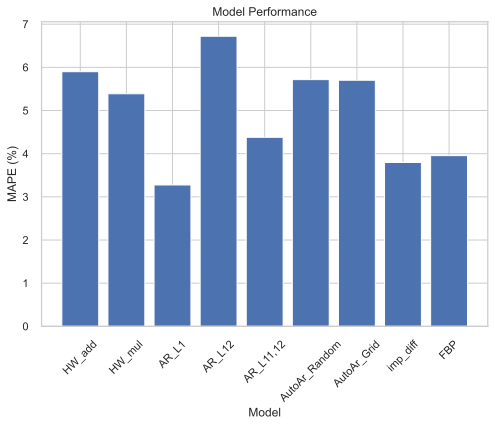

In [215]:
keys = me.keys()
values = me.values()
plt.xticks(rotation = 45)
plt.title("Model Performance")
plt.ylabel('MAPE (%)')
plt.xlabel('Model')
plt.bar(keys, values)


Conclusion:

Interestingly the simplest and least automated model, the AR model L1 performed the best. Second up, was the SARIMAX Implicit difference model which used the parameters defined by AutoArima's grid search. Followed closely by Facebook's prophet. The worst performing was the L12 AR model, followed by Holt Winters Exponential Smoothing set to 'Additive' for both the the trend and seasonality. The Holt-Winters model with seasonality set to Multiplicative didn't perform as badly, performing better than both the models produced by AutoArima set to Random Search & Grid Search.

## When will Renewable Gen fulfil Energy Demand?

We saw earlier in our EDA that Energy Consumption was dropping while Renewable Generation was increasing at a constant rate, ie. both of these datasets are converging. 

As a thought experiment, let's see if we can isolate, based on the current trajectory of both datasets' trends, exactly when we will be able to fulfil all of our National Energy Demand with Renewable Energy. 

There are many external factors that will be affecting our ability to accurately forecast so far into the future. This includes macro-economics, politics, technological advances (cost of tech). The below does not claim to give the real answer, but will be helpful in contextualizing our trajectory as a nation in becoming a self-sufficient and 'green'.

### Isolating Trends


We won't be using our monthly averaged data because we are forecasting many years into the future. As such it's best to decompose the data in order to isolate the trend by taking the annual mean for both sets. This allows us to remove the noise, and leaves us with just the trajectory of the overall data.


#### Decompose Data

In [216]:
# Decompose the renewable dataset
rnw_decom = tsa.seasonal_decompose(dfM['renewable'], model='multi', period = 12)

In [217]:
# Decompose the demand dataset
dmnd_decom = tsa.seasonal_decompose(dfM['demand_national'], model='multi', period = 12)

In [218]:
# Create dataframe with just the trend data we need
trend = pd.DataFrame(rnw_decom.trend)
trend["renewable"] = rnw_decom.trend
trend["demand_national"] = dmnd_decom.trend

In [219]:
trend.drop('trend',inplace=True,axis=1)

<AxesSubplot:title={'center':'Demand & Renewable Trends'}, xlabel='Years', ylabel='Energy Demand (MW)'>

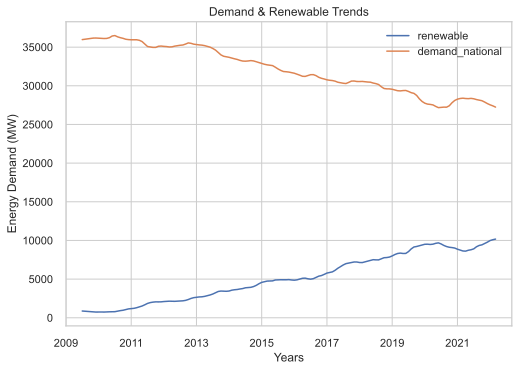

In [220]:
trend.plot(title="Demand & Renewable Trends", xlabel = 'Years', ylabel='Energy Demand (MW)')

### Linear regression of Trends

Below we will perform linear regression on the trend lines to find the line of least squares (best fit). By doing this we are able to simplify the trends' trajectories into a simple linear equation.

#### Fitting Renewable Trend Data

In [221]:
# Removing the NaNs caused by differencing
trend.dropna(inplace=True)

In [232]:
trend.index.size


153

In [222]:
# We cannot perform linear regression using a timeseries index, we must input the x values as the number of rows instead
x = np.arange(trend.index.size)

fit = np.polyfit(x, trend['renewable'], deg=1)
print ("Slope : " + str(fit[0]))
print ("Intercept : " + str(fit[1]))

#Fit function : y = mx + c [linear regression ]
renew_fit = np.poly1d(fit)

Slope : 67.34496870273378
Intercept : 38.03561689468044


We can see from the above that the renewable line of best fit is moving in a positive direction, this gives us confidence that the line was fit properly.

#### Fitting Demand Trend Data

In [223]:
x = np.arange(trend.index.size)

fit = np.polyfit(x, trend['demand_national'], deg=1)
print ("Slope : " + str(fit[0]))
print ("Intercept : " + str(fit[1]))

#Fit function : y = mx + c [linear regression ]
demand_fit = np.poly1d(fit)

Slope : -66.40900873420162
Intercept : 37112.88307255203


Conversely to above, we can see that the demand line of best fit is moving in a negative direction, this also gives us confidence that the line was fit properly.

### Plotting our Trend and Line 

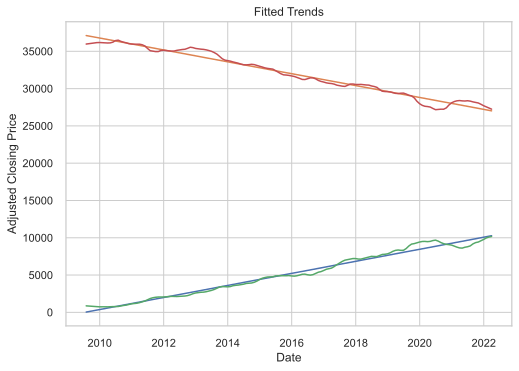

In [224]:
#Linear regression plot
plt.plot((trend.index), renew_fit(x))
plt.plot(trend.index, demand_fit(x))
#Time series data plot
plt.plot(trend.index, trend['renewable'])
plt.plot(trend.index, trend['demand_national'])
plt.xlabel('Date')
plt.ylabel('Adjusted Closing Price')
plt.title('Fitted Trends')
plt.show()

We can see above that our lines were perfectly fit, catching the trajectory of the trend lines perfectly. Interestingly both lines slopes are almost identical in the opposite y-direction. 

### Finding the intersection point

In order to find the intersection point we will first use what we know about the lines plotted above, to recreate the lines using linear algebra.

In [225]:
# Create a series of potential X values that we want to iterate through
x = np.arange(0,300,1)

# Renewable: y = mx + c
y1=67.34496870273378*x + 38.03561689468044

# Demand: y = mx + c
y2=-66.40900873420162*x + 37112.88307255203

We will then use the numpy root function to solve for the intersection of both lines by feeding in the difference between both the line's gradients and constants

In [226]:
inter = int(np.roots([-66.40900873420162-67.34496870273378,37112.88307255203-38.03561689468044]))

In [231]:
inter

277

The above value tells us the row number value for the intersection point. 
In order to isolate a date we must use the date_range tool to find which month this intersection point will fall in:

In [227]:
pd.date_range('2009-07-31',periods=inter,freq='m')

DatetimeIndex(['2009-07-31', '2009-08-31', '2009-09-30', '2009-10-31',
               '2009-11-30', '2009-12-31', '2010-01-31', '2010-02-28',
               '2010-03-31', '2010-04-30',
               ...
               '2031-10-31', '2031-11-30', '2031-12-31', '2032-01-31',
               '2032-02-29', '2032-03-31', '2032-04-30', '2032-05-31',
               '2032-06-30', '2032-07-31'],
              dtype='datetime64[ns]', length=277, freq='M')

### Intersection point

Below we will plot the intersection points as well as the trends to 

In [228]:
print(f"The intersection point is {pd.date_range('2009-07-31',periods=inter,freq='m').max()} ")

The intersection point is 2032-07-31 00:00:00 


This can be visualised below:

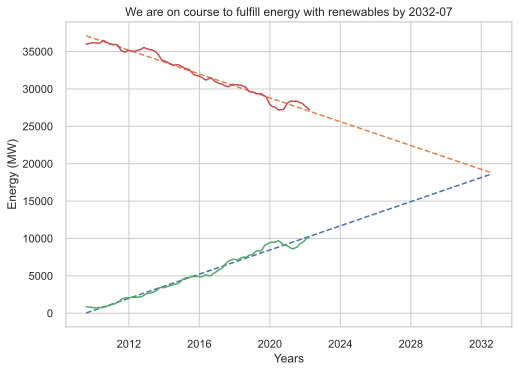

In [229]:
plt.plot(pd.date_range('2009-07-31',periods=inter,freq='m'),y1[:inter],linestyle='--')
plt.title('We are on course to fulfill energy with renewables by 2032-07')
plt.xlabel('Years')
plt.ylabel('Energy (MW)')
plt.plot(pd.date_range('2009-07-31',periods=inter,freq='m'),y2[:inter],linestyle='--')
plt.plot(trend.index, trend['renewable'])
plt.plot(trend.index, trend['demand_national'])

In [230]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=pd.date_range('2009-07-31',periods=inter,freq='m'), y=y1[:inter], mode='lines', name="Renewable Trajectory",line={'dash': 'dot'}))
fig.add_trace(go.Scatter(x=pd.date_range('2009-07-31',periods=inter,freq='m'), y=y2[:inter], mode='lines', name="Demand Trajectory",line={'dash': 'dot'}))
fig.add_trace(go.Scatter(x=trend.index, y=trend['renewable'], mode='lines', name="Demand Trend"))
fig.add_trace(go.Scatter(x=trend.index, y=trend['demand_national'], mode='lines', name="Renewable Trend"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(title_text="On course to fulfill national energy with renewables by 2032-07", title_x=0.45)
fig.update_layout(
    yaxis_title="Energy Demand (MW)", 
    xaxis_title="Date",
)
fig.show()

The above visualisation shows us that we are on course to fulfil total energy demand with renewables by July 2023. We should take this with a pinch of salt, simplifying such a trend 10 years into the future using a linear trajectory is most likely an over simplification of what should most likely be a polynomial trend.